In [39]:
#import numpy, scipy, math and astropy libraries
import numpy as np
import scipy as sp
import math
import astropy

#import rpy2 to allow access to R statistics packages.
import rpy2
import rpy2.robjects as robjects
from rpy2.robjects.packages import importr 
from rpy2.robjects.vectors import StrVector
from rpy2.robjects.vectors import BoolVector
import rpy2.robjects.packages as rpackages # import rpy2's package module
from rpy2.robjects.methods import getmethod
#import rpy2.rpy_classic as rpy
from multipledispatch import dispatch
from functools import partial
from rpy2.robjects.methods import RS4   

#import functions for reading data tables
from astropy.io import ascii
from astropy.table import Table, Column

#import packages that stephanie's fit_rossby.py scripts rely on
import emcee
import corner

#load functions originally written by Stephanie Douglas for her 2014 paper, 
#(see the repo at https://github.com/stephtdouglas/fit-rossby)
#and subsequently modified by KRC in 2019, as stored in fit_rossby.py in my fork
%run ../scripts/fit_rossby_log.py

#also load a copy of this file, which allows a dual power law fit to be run.
%run ../scripts/dual_power_law.py

In [3]:
#import graphics packages
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.mlab as mlab
import matplotlib.colorbar as cb

#set plotting defaults to values that make plots look publication ready
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('pdf', 'png')
plt.rcParams['savefig.dpi'] = 300
plt.rcParams['figure.autolayout'] = False
plt.rcParams['figure.figsize'] = 11, 7
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['font.size'] = 14
plt.rcParams['lines.linewidth'] = 1.5
plt.rcParams['lines.markersize'] = 4
plt.rcParams['legend.fontsize'] = 11
matplotlib.rcParams['xtick.direction'] = 'out'
matplotlib.rcParams['ytick.direction'] = 'out'

#ensure that plots show up in our notebook (comment this out if converting to a script)
%matplotlib inline

In [7]:
#set up a list of the paths that change between laptop & desktop
#WrightData = Table.read("/Users/kcovey/Dropbox/python/fit-rossby/data/nature18638-f1_KRCedits.csv", data_start=1, delimiter=',')
WrightData = Table.read("/Users/coveyk/Dropbox/python/fit-rossby/data/nature18638-f1_KRCedits.csv", data_start=1, delimiter=',')

#read in Enza's data Table (after adjusting file format and switching some encodings on minus signs)
#prior plots were derived from Final_Results_wMKs.csv
#dataTable = Table.read("/Users/coveyk/Dropbox/python/fit-rossby/data/Very_Last_Results.csv", data_start=1, delimiter=',')
#dataTable = Table.read("/Users/kcovey/Dropbox/python/fit-rossby/data/Very_Last_Results.csv", data_start=1, delimiter=',')
#dataTable = Table.read("/Users/kcovey/Dropbox/python/fit-rossby/data/Very_Last_Results_Wr11_16_18_Stz_Gonz_Mag_KEVIN.csv", data_start=1, delimiter=',')
dataTable = Table.read("/Users/coveyk/Dropbox/python/fit-rossby/data/EnzaFile_Nov6.csv", data_start=1, delimiter=',')
#dataTable.info()

## Test Plots of the Wright 2011 data (should probably delete)

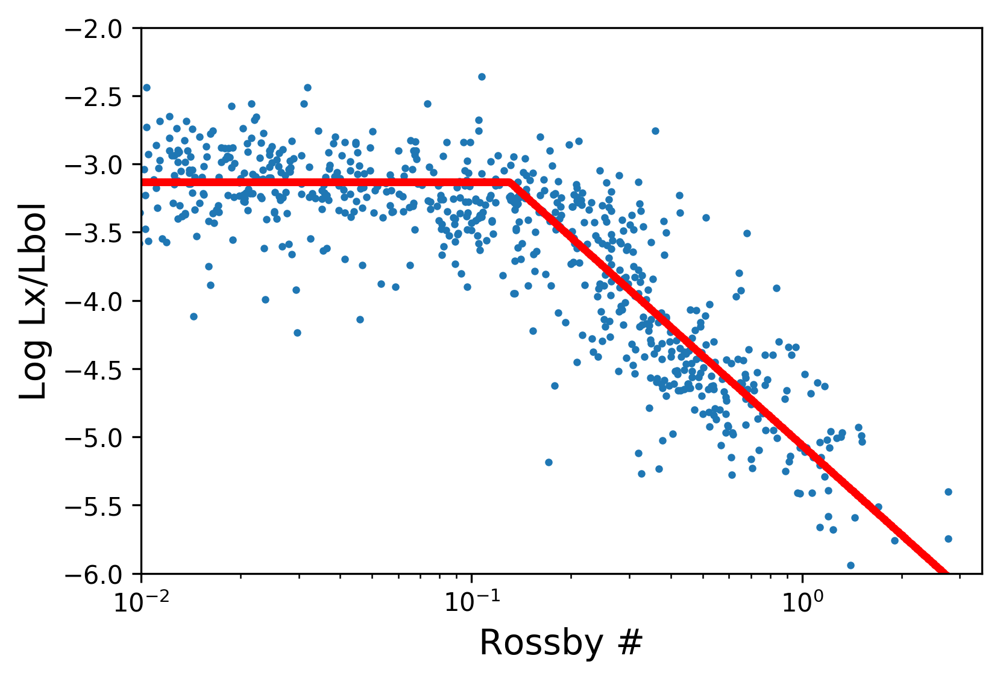

In [8]:
#read in Wright 2011 data Table that Enza provided 
num_WrightSources = len(np.asarray(WrightData['RA']))
#print(num_WrightSources)

#plot the Rossby plot for the Wright 2011 data 
plt.scatter(WrightData['Rossby_number'], WrightData['log(Lx/Lbol)'], marker = '.')

#overlay the best fit power law parameters from Wright 2011
fake_rossbys = np.logspace(-2, 0.5, 1000)
Wright2011Law = rossby_model_log([-3.13, 0.13, -2.18], fake_rossbys)
plt.scatter(fake_rossbys, Wright2011Law, marker = '.', color = 'red')

#set up all the figure parameters
plt.xscale('log')
#plt.yscale('log')
xlabel = plt.xlabel('Rossby #') 
ylabel = plt.ylabel('Log Lx/Lbol')
plt.axis([10**(-2),3.5,-6,-2])

plt.savefig('wright_rossby.png', bbox_inches='tight') 

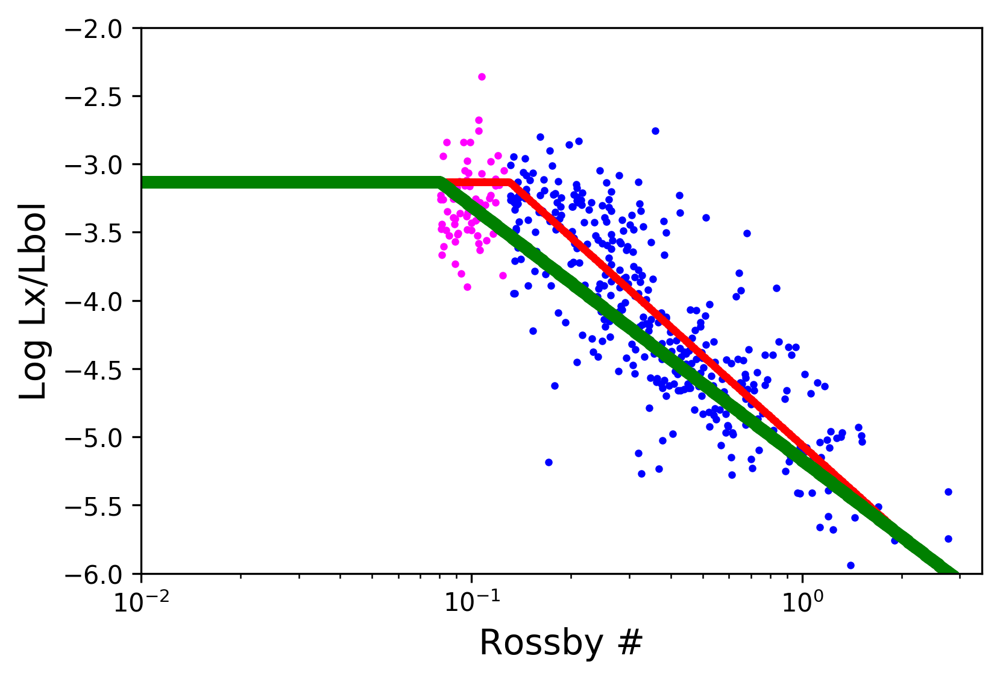

In [9]:
#now try fitting the Wright data and see if that is what we recover.

#first truncate the powerlaw at the point that Wright truncates it: Ro = 0.13
slow_Wright_rossbys = WrightData['Rossby_number'][(np.asarray(WrightData['Rossby_number']) > 0.13)]
slow_Wright_fluxes = WrightData['log(Lx/Lbol)'][(np.asarray(WrightData['Rossby_number']) > 0.13)]
num_slow_Wright = len(slow_Wright_fluxes)
slow_Wright_Flags = np.full(num_slow_Wright, False)

medium_Wright_rossbys = WrightData['Rossby_number'][(np.asarray(WrightData['Rossby_number']) > 0.08) & (np.asarray(WrightData['Rossby_number']) < 0.13)]
medium_Wright_fluxes = WrightData['log(Lx/Lbol)'][(np.asarray(WrightData['Rossby_number']) > 0.08) & (np.asarray(WrightData['Rossby_number']) < 0.13)]

#plot just the unsaturated regime
plt.scatter(slow_Wright_rossbys, slow_Wright_fluxes, marker = '.', color = 'blue')
plt.scatter(medium_Wright_rossbys, medium_Wright_fluxes, marker = '.', color = 'magenta')

plt.scatter(fake_rossbys, Wright2011Law, marker = '.', color = 'red')
ShallowWright2011Law = rossby_model_log([-3.13, 0.08, -1.86], fake_rossbys)
plt.scatter(fake_rossbys, ShallowWright2011Law, linestyle = '-', color = 'green')

#set up all the figure parameters
plt.xscale('log')
#plt.yscale('log')
xlabel = plt.xlabel('Rossby #') 
ylabel = plt.ylabel('Log Lx/Lbol')
plt.axis([10**(-2),3.5,-6,-2])

plt.savefig('wright_rossby_wfit.png', bbox_inches='tight') 

## Test Cenken fit on Wright 2011 data (should probably delete)

In [10]:
#now try to do fit using R to do an upper limit sensitive approach

# import R's "base" package
base = importr('base')

# import R's "utils" package
utils = rpackages.importr('utils') # import R's utility package

#install NADA once, then just import
#utils.install_packages('NADA')
utils.chooseCRANmirror(ind=1) # select the first CRAN mirror in the list for downloading packages
nada = rpackages.importr('NADA') # import R's utility package

#now load the cenken package that we want to use to do the line fitting
cenken = robjects.r['cenken']

slow_Wright_rossbys = WrightData['Rossby_number'][(np.asarray(WrightData['Rossby_number']) > 0.08)]
slow_Wright_fluxes = WrightData['log(Lx/Lbol)'][(np.asarray(WrightData['Rossby_number']) > 0.08)]
num_slow_Wright = len(slow_Wright_fluxes)
slow_Wright_Flags = np.full(num_slow_Wright, False)
#set a couple upper limit flags to true to test if that kills the intercept
test_Wright_Flags = np.copy(slow_Wright_Flags)
test_Wright_Flags[3:5] = True

#since that worked ok, now save the vectors to send to r (and convert rossbys to log space, since that is what we want to fit)
wright_cenken_rossbys = robjects.FloatVector(np.log10(slow_Wright_rossbys) )
wright_cenken_fluxes = robjects.FloatVector(slow_Wright_fluxes)
wright_cenken_Flags = robjects.BoolVector(slow_Wright_Flags)
wright_test_Flags = robjects.BoolVector(test_Wright_Flags)

#run the fit!  (remember that cenken wants y values before xs)
Wright_cenkenout = cenken(wright_cenken_fluxes, wright_cenken_Flags, wright_cenken_rossbys, wright_test_Flags)
print(Wright_cenkenout)

#fit gives slope of -2.17 when Wright's turnover (R_sat = 0.13) is used; 
#slope drops to -1.86 when closer turnover (R_sat = 0.08) is used.

slope 
[1] -1.86232

intercept 
[1] -5.011403

tau 
[1] -0.6362188

p 
[1] 0




## Selecting different mass ranges (and upper limits) in Enza's data

In [11]:
#Slice and dice Enza's sample

#First record the flags
upperlimits = np.where(dataTable['UpperLimit'] == 1)
detections = np.where(dataTable['UpperLimit'] == 0)

#then select the mass slices
highMass = np.where(dataTable['Mass[Msun]'] > 0.6)
medMass = np.where( (dataTable['Mass[Msun]'] <= 0.6) & (dataTable['Mass[Msun]'] >= 0.4) )
lowMass = np.where(dataTable['Mass[Msun]'] < 0.4)

#then select the mass slices but require detections!
highMass_detect = np.where( (dataTable['Mass[Msun]'] > 0.6) & (dataTable['UpperLimit'] == 0) )
medMass_detect = np.where( (dataTable['Mass[Msun]'] <= 0.6) & (dataTable['Mass[Msun]'] >= 0.4)  & (dataTable['UpperLimit'] == 0))
lowMass_detect = np.where( (dataTable['Mass[Msun]'] < 0.4)  & (dataTable['UpperLimit'] == 0) )

#then select the mass slices but require upper limits.
highMass_limit = np.where( (dataTable['Mass[Msun]'] > 0.6) & (dataTable['UpperLimit'] == 1) )
medMass_limit = np.where( (dataTable['Mass[Msun]'] <= 0.6) & (dataTable['Mass[Msun]'] >= 0.4)  & (dataTable['UpperLimit'] == 1))
lowMass_limit = np.where( (dataTable['Mass[Msun]'] < 0.4)  & (dataTable['UpperLimit'] == 1) )

#finally, split off the slow & low sources
slowAndLow = np.where( (dataTable['Mass[Msun]'] < 0.4) & (dataTable['Prot[d]'] > 30) )
#slowAndLow = np.where( (dataTable['Mass[Msun]'] < 0.4) & (dataTable['Prot[d]'] > 7.0) & (dataTable['UpperLimit'] = 0) )

#print(dataTable['Mass[Msun]'][lowMass])

## Plotting Period / Lx diagram to visually inspect sample

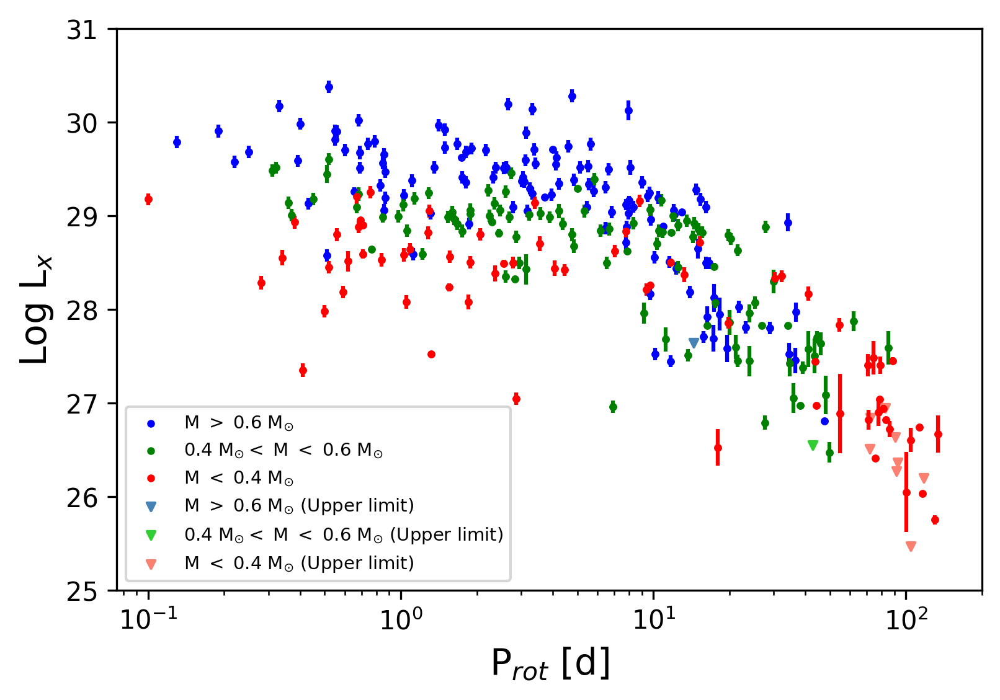

In [12]:
#plot Enza's data
plt.scatter(dataTable['Prot[d]'][highMass_detect], dataTable['Lx[erg/s]'][highMass_detect], marker = '.', color = 'blue', label=r'M $>$ 0.6 M$_{\odot}$')
plt.errorbar(dataTable['Prot[d]'][highMass_detect], dataTable['Lx[erg/s]'][highMass_detect], dataTable['eLx[erg/s]'][highMass_detect], fmt = '.', color = 'blue')
plt.scatter(dataTable['Prot[d]'][medMass_detect], dataTable['Lx[erg/s]'][medMass_detect], marker = '.', color = 'green', label=r'0.4 M$_{\odot} <$ M $<$ 0.6 M$_{\odot}$')
plt.errorbar(dataTable['Prot[d]'][medMass_detect], dataTable['Lx[erg/s]'][medMass_detect], dataTable['eLx[erg/s]'][medMass_detect], fmt = '.', color = 'green')
plt.scatter(dataTable['Prot[d]'][lowMass_detect], dataTable['Lx[erg/s]'][lowMass_detect], marker = '.', color = 'red', label=r'M $<$ 0.4 M$_{\odot}$')
plt.errorbar(dataTable['Prot[d]'][lowMass_detect], dataTable['Lx[erg/s]'][lowMass_detect], dataTable['eLx[erg/s]'][lowMass_detect], fmt = '.', color = 'red')

plt.scatter(dataTable['Prot[d]'][highMass_limit], dataTable['Lx[erg/s]'][highMass_limit], marker = 'v', s = 10, color = 'steelblue', label=r'M $>$ 0.6 M$_{\odot}$ (Upper limit)')
plt.scatter(dataTable['Prot[d]'][medMass_limit], dataTable['Lx[erg/s]'][medMass_limit], marker = 'v', s = 10, color = 'limegreen', label=r'0.4 M$_{\odot} <$ M $<$ 0.6 M$_{\odot}$ (Upper limit)')
plt.scatter(dataTable['Prot[d]'][lowMass_limit], dataTable['Lx[erg/s]'][lowMass_limit], marker = 'v', s = 10, color = 'salmon', label=r'M $<$ 0.4 M$_{\odot}$ (Upper limit)')

#plt.scatter(dataTable['Prot[d]'][upperlimits], dataTable['Lx[erg/s]'][upperlimits], marker = 'v')

plt.xscale('log')
#plt.yscale('log')
xlabel = plt.xlabel(r'P$_{rot}$ [d]') 
ylabel = plt.ylabel(r'Log L$_x$')
plt.axis([0.075,200,25,31])
plt.legend(fontsize = 7)

##check that the log version of the model function is working by calculating model values 
##for the set of fake Rossby's that we created to test the Wright Data
#fake_Log_lxlbols_shallow = rossby_model_log([-3.23, 0.08, -1.625], fake_rossbys)
#plt.scatter(fake_rossbys, fake_Log_lxlbols_shallow, marker = '.', color = 'green')
#fake_Log_lxlbols_steep = rossby_model_log([-3.23, 0.13, -1.66], fake_rossbys)
#plt.scatter(fake_rossbys, fake_Log_lxlbols_steep, marker = '.', color = 'red')

plt.savefig('enza_Prot_Lx_withMasses.png', bbox_inches='tight') 

## Dual power law fit via emcee for all detections in the sample

/Users/coveyk/anaconda/lib/python3.6/site-packages/emcee/ensemble.py:335: RuntimeWarning: invalid value encountered in subtract
  lnpdiff = (self.dim - 1.) * np.log(zz) + newlnprob - lnprob0
/Users/coveyk/anaconda/lib/python3.6/site-packages/emcee/ensemble.py:336: RuntimeWarning: invalid value encountered in greater
  accept = (lnpdiff > np.log(self._random.rand(len(lnpdiff))))


intercept constant=30.7817888 +0.2045652/-0.2209258
turnover=7.132 +1.227/-1.257
beta1=-0.106 +0.112/-0.119
beta2=-2.024 +0.153/-0.145
var=-3.970 +0.042/-0.043


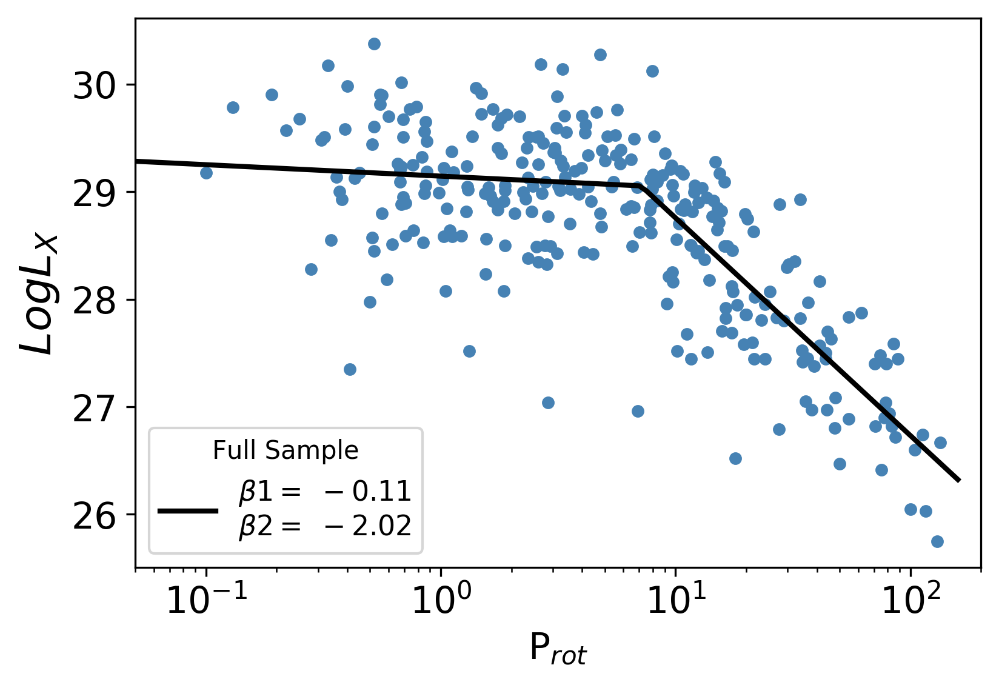

In [13]:
# Decide on your starting parameters
start_p = np.asarray([29.2, 6, -0.15, -1.7, 0.2])

# run the emcee wrapper function -- include all data (including lower limits)
samples = run_dual_fit_periods(start_p, np.asarray(dataTable['Prot[d]'][detections]), np.asarray(dataTable['Lx[erg/s]'][detections]), np.asarray(dataTable['eLx[erg/s]'][detections]) )
#returns: beta1 = -0.1, beta2 = -2.02, turnover = 7.08

# Plot the output
plot_dual_fit_periods(samples, np.asarray(dataTable['Prot[d]'][detections]), np.asarray(dataTable['Lx[erg/s]'][detections]),  np.asarray(dataTable['eLx[erg/s]'][detections]), plotfilename = 'enza_datapoints_dual_fit_periods.png', sampleName = 'Full Sample')

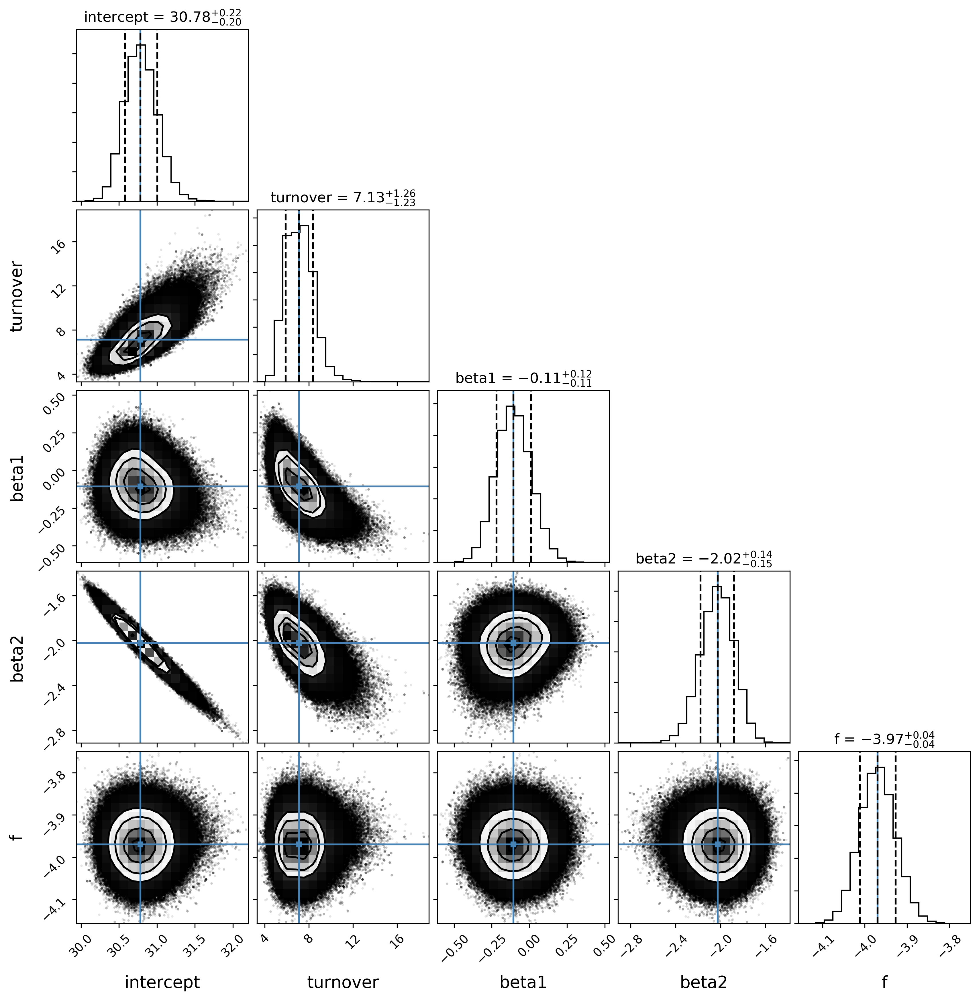

In [14]:
# Make a triangle plot 

# Set up the parameters of the problem.
ndim, nsamples = 5, len(samples) 

ic_mcmc = quantile(samples[:,0],[.16,.5,.84])
to_mcmc = quantile(samples[:,1],[.16,.5,.84])
beta1_mcmc = quantile(samples[:,2],[.16,.5,.84])
beta2_mcmc = quantile(samples[:,3],[.16,.5,.84])
var_mcmc = quantile(samples[:,4],[.16,.5,.84])

bestFit = [ic_mcmc[1][1], to_mcmc[1][1], beta1_mcmc[1][1], beta2_mcmc[1][1], var_mcmc[1][1]]

# Plot it.
figure = corner.corner(samples, labels=['intercept','turnover','beta1', 'beta2', 'f'],
                       quantiles=[0.16, 0.5, 0.84],
                       show_titles=True, title_kwargs={"fontsize": 12}, truths = bestFit)

# Uncomment to save the plot
plt.savefig('enza_datapoints_dual_fit_corner_periods.png')

## Unconstrained dual-power law fit to high mass slice

/Users/coveyk/anaconda/lib/python3.6/site-packages/emcee/ensemble.py:335: RuntimeWarning: invalid value encountered in subtract
  lnpdiff = (self.dim - 1.) * np.log(zz) + newlnprob - lnprob0
/Users/coveyk/anaconda/lib/python3.6/site-packages/emcee/ensemble.py:336: RuntimeWarning: invalid value encountered in greater
  accept = (lnpdiff > np.log(self._random.rand(len(lnpdiff))))


intercept constant=31.1055770 +0.2754930/-0.3061895
turnover=5.486 +0.775/-1.048
beta1=-0.169 +0.137/-0.135
beta2=-2.250 +0.267/-0.251
var=-4.239 +0.067/-0.073


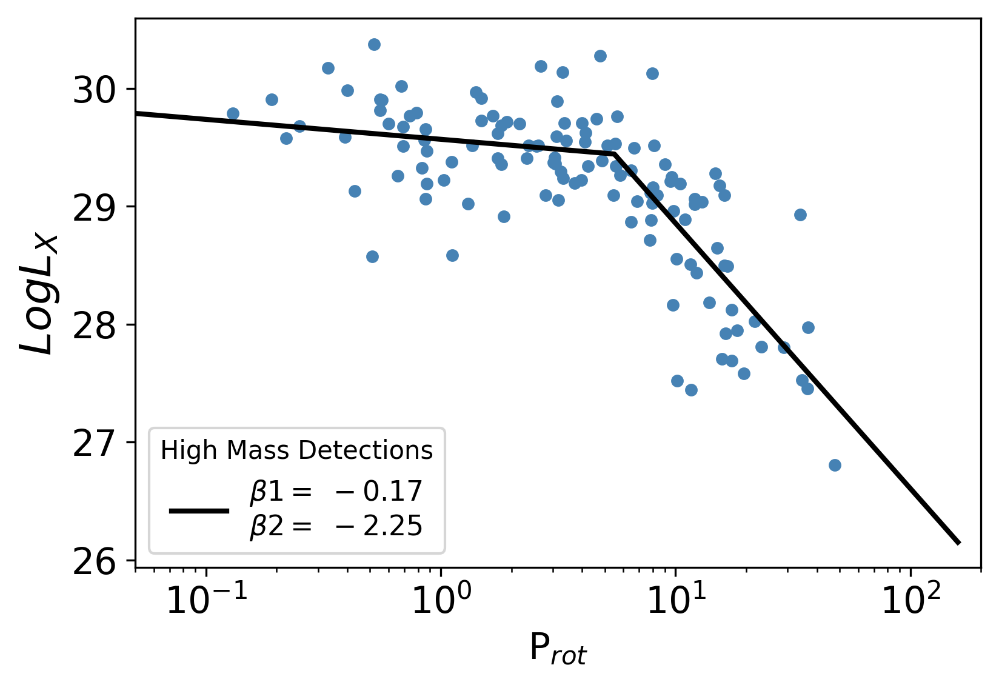

In [22]:
# Decide on your starting parameters
start_p = np.asarray([29.2, 6, -0.15, -1.7, 0.2])

# run the emcee wrapper function -- include all data (including lower limits)
samples = run_dual_fit_periods(start_p, np.asarray(dataTable['Prot[d]'][highMass_detect]), np.asarray(dataTable['Lx[erg/s]'][highMass_detect]), np.asarray(dataTable['eLx[erg/s]'][highMass_detect]) )
#returns: beta1 = -0.1, beta2 = -2.02, turnover = 7.08

# Plot the output
plot_dual_fit_periods(samples, np.asarray(dataTable['Prot[d]'][highMass_detect]), np.asarray(dataTable['Lx[erg/s]'][highMass_detect]),  np.asarray(dataTable['eLx[erg/s]'][highMass_detect]), plotfilename = 'enza_highMass_dual_fit_periods.png', sampleName = 'High Mass Detections')

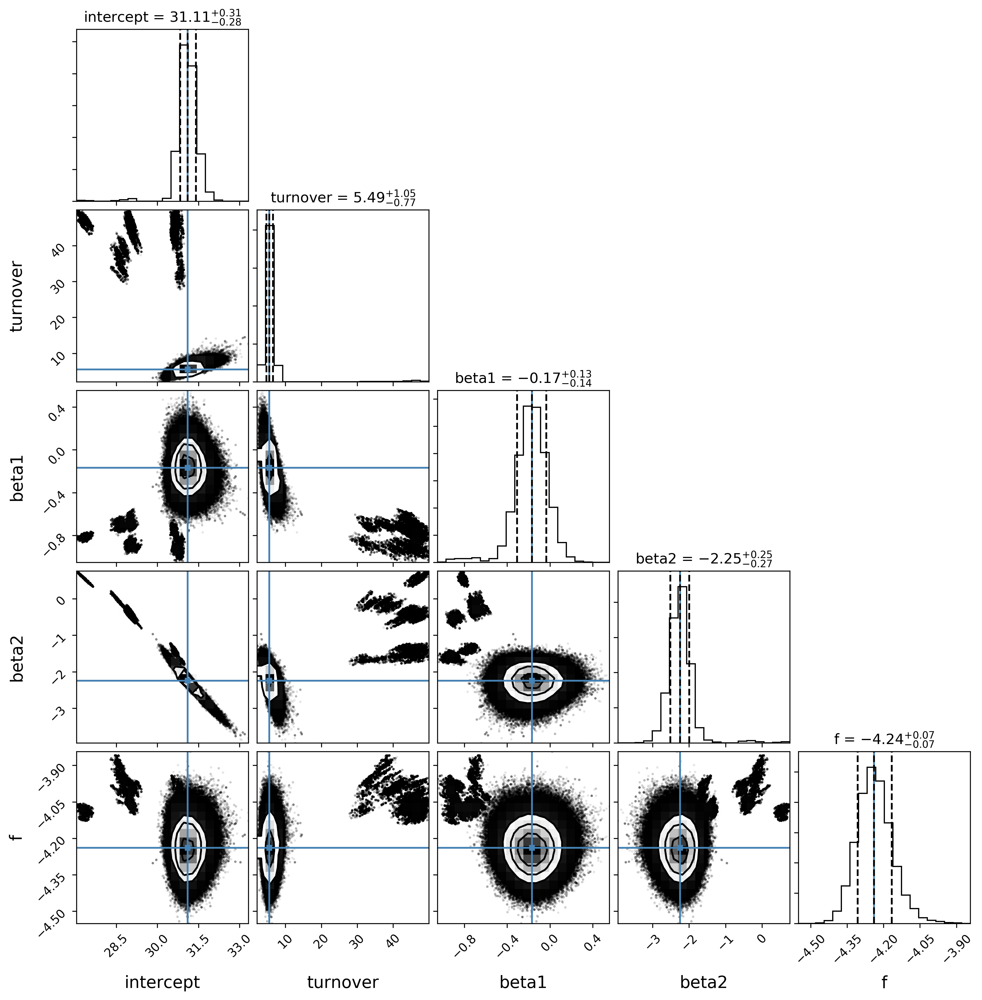

In [23]:
# Make a triangle plot 

# Set up the parameters of the problem.
ndim, nsamples = 5, len(samples) 

ic_mcmc = quantile(samples[:,0],[.16,.5,.84])
to_mcmc = quantile(samples[:,1],[.16,.5,.84])
beta1_mcmc = quantile(samples[:,2],[.16,.5,.84])
beta2_mcmc = quantile(samples[:,3],[.16,.5,.84])
var_mcmc = quantile(samples[:,4],[.16,.5,.84])

bestFit = [ic_mcmc[1][1], to_mcmc[1][1], beta1_mcmc[1][1], beta2_mcmc[1][1], var_mcmc[1][1]]

# Plot it.
figure = corner.corner(samples, labels=['intercept','turnover','beta1', 'beta2', 'f'],
                       quantiles=[0.16, 0.5, 0.84],
                       show_titles=True, title_kwargs={"fontsize": 12}, truths = bestFit)

# Uncomment to save the plot
plt.savefig('enza_highMass_dual_fit_corner_periods.png')

## Unconstrained dual-power law fit to mid-range mass slice

/Users/coveyk/anaconda/lib/python3.6/site-packages/emcee/ensemble.py:335: RuntimeWarning: invalid value encountered in subtract
  lnpdiff = (self.dim - 1.) * np.log(zz) + newlnprob - lnprob0
/Users/coveyk/anaconda/lib/python3.6/site-packages/emcee/ensemble.py:336: RuntimeWarning: invalid value encountered in greater
  accept = (lnpdiff > np.log(self._random.rand(len(lnpdiff))))


intercept constant=30.9024228 +0.4546914/-0.5123028
turnover=12.673 +2.600/-2.875
beta1=-0.432 +0.123/-0.131
beta2=-2.087 +0.354/-0.325
var=-4.189 +0.074/-0.077


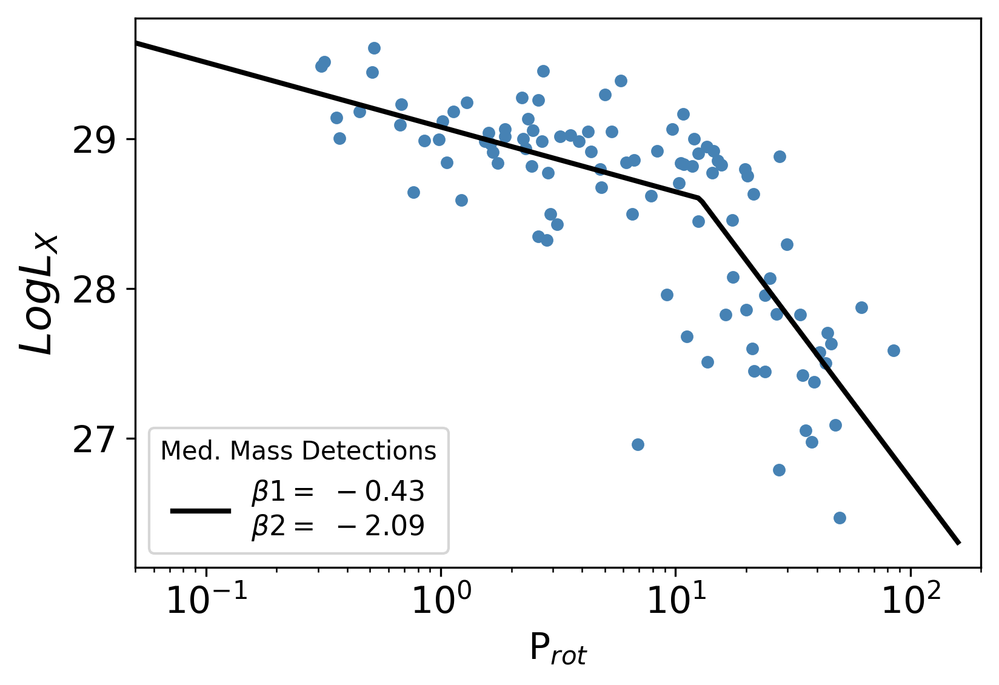

In [13]:
# Decide on your starting parameters
start_p = np.asarray([29.2, 6, -0.15, -1.7, 0.2])

# run the emcee wrapper function -- include all data (including lower limits)
samples = run_dual_fit_periods(start_p, np.asarray(dataTable['Prot[d]'][medMass_detect]), np.asarray(dataTable['Lx[erg/s]'][medMass_detect]), np.asarray(dataTable['eLx[erg/s]'][medMass_detect]) )
#returns: beta1 = -0.1, beta2 = -2.02, turnover = 7.08

# Plot the output
plot_dual_fit_periods(samples, np.asarray(dataTable['Prot[d]'][medMass_detect]), np.asarray(dataTable['Lx[erg/s]'][medMass_detect]),  np.asarray(dataTable['eLx[erg/s]'][medMass_detect]), plotfilename = 'enza_medMass_dual_fit_periods.png', sampleName = 'Med. Mass Detections')

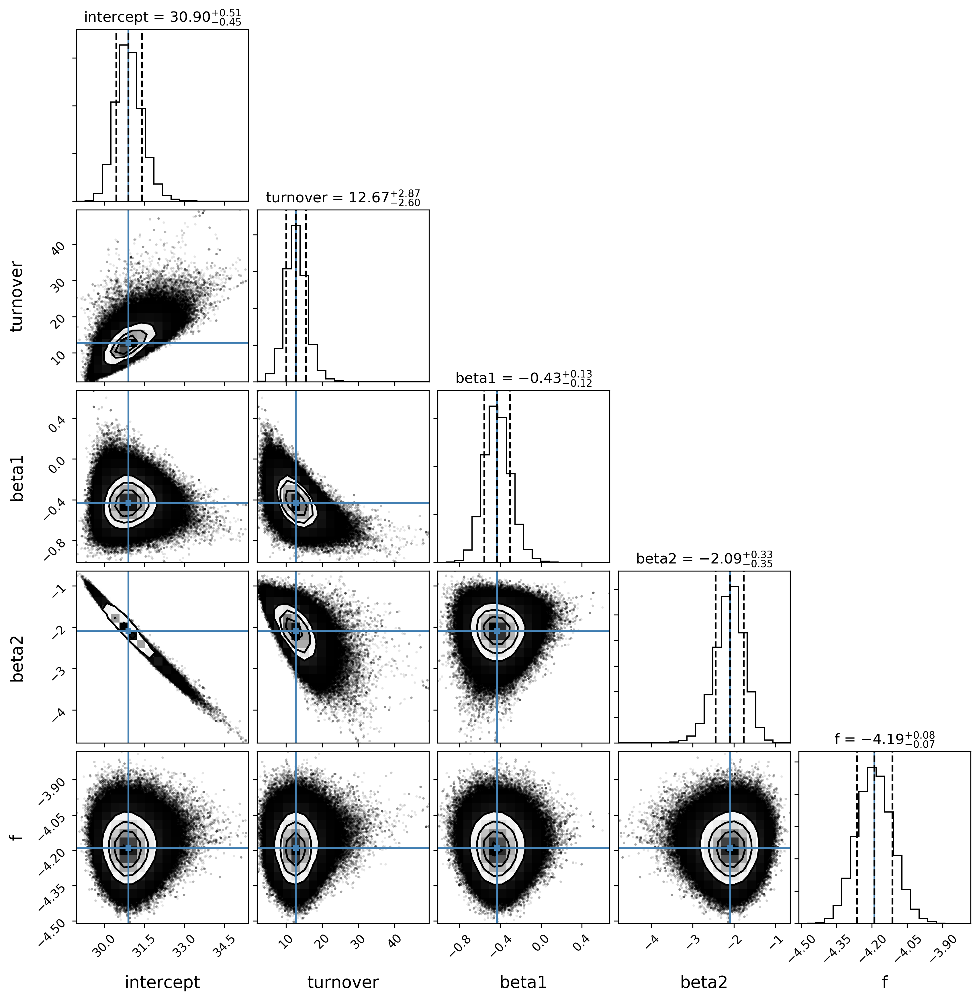

In [14]:
# Make a triangle plot 

# Set up the parameters of the problem.
ndim, nsamples = 5, len(samples) 

ic_mcmc = quantile(samples[:,0],[.16,.5,.84])
to_mcmc = quantile(samples[:,1],[.16,.5,.84])
beta1_mcmc = quantile(samples[:,2],[.16,.5,.84])
beta2_mcmc = quantile(samples[:,3],[.16,.5,.84])
var_mcmc = quantile(samples[:,4],[.16,.5,.84])

bestFit = [ic_mcmc[1][1], to_mcmc[1][1], beta1_mcmc[1][1], beta2_mcmc[1][1], var_mcmc[1][1]]

# Plot it.
figure = corner.corner(samples, labels=['intercept','turnover','beta1', 'beta2', 'f'],
                       quantiles=[0.16, 0.5, 0.84],
                       show_titles=True, title_kwargs={"fontsize": 12}, truths = bestFit)

# Uncomment to save the plot
plt.savefig('enza_medMass_dual_fit_corner_periods.png')

## Unconstrained dual-power law fit to low mass slice

intercept constant=32.6926370 +1.3309573/-1.2702978
turnover=30.729 +9.328/-7.934
beta1=-0.222 +0.132/-0.144
beta2=-3.029 +0.673/-0.706
var=-4.055 +0.088/-0.093


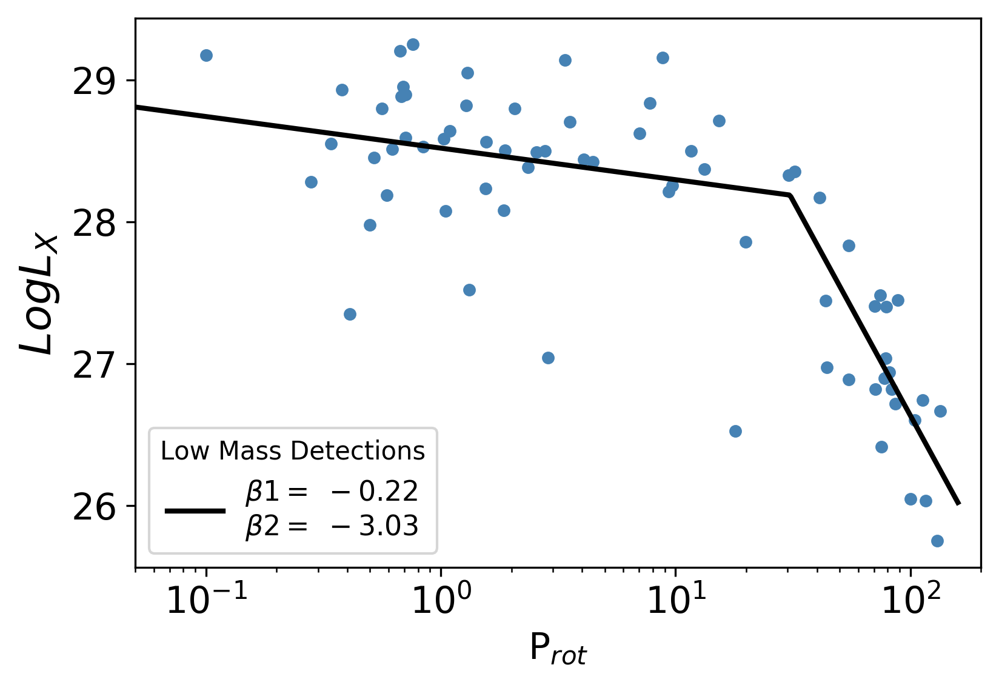

In [15]:
# Decide on your starting parameters
start_p = np.asarray([29.2, 6, -0.15, -1.7, 0.2])

# run the emcee wrapper function -- include all data (including lower limits)
samples = run_dual_fit_periods(start_p, np.asarray(dataTable['Prot[d]'][lowMass_detect]), np.asarray(dataTable['Lx[erg/s]'][lowMass_detect]), np.asarray(dataTable['eLx[erg/s]'][lowMass_detect]) )
#returns: beta1 = -0.1, beta2 = -2.02, turnover = 7.08

# Plot the output
plot_dual_fit_periods(samples, np.asarray(dataTable['Prot[d]'][lowMass_detect]), np.asarray(dataTable['Lx[erg/s]'][lowMass_detect]),  np.asarray(dataTable['eLx[erg/s]'][lowMass_detect]), plotfilename = 'enza_lowMass_dual_fit_periods.png', sampleName = 'Low Mass Detections')

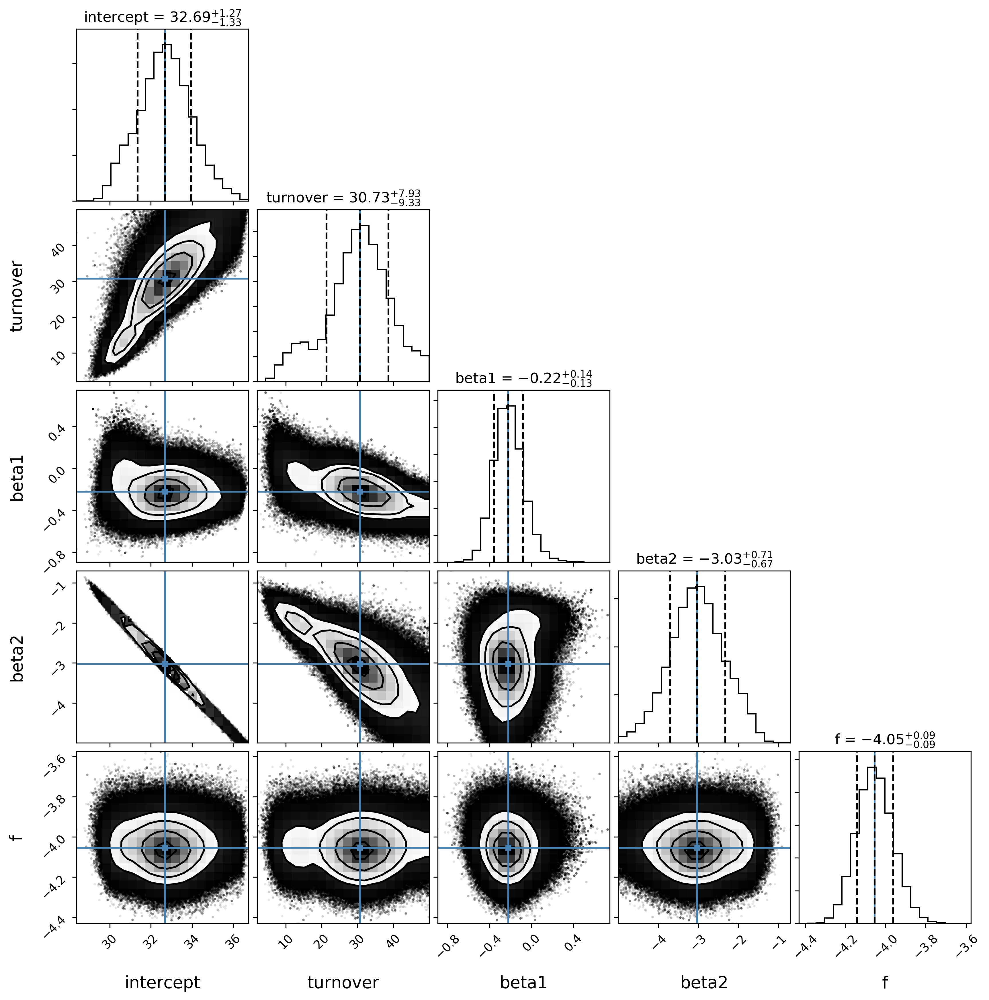

In [16]:
# Make a triangle plot 

# Set up the parameters of the problem.
ndim, nsamples = 5, len(samples) 

ic_mcmc = quantile(samples[:,0],[.16,.5,.84])
to_mcmc = quantile(samples[:,1],[.16,.5,.84])
beta1_mcmc = quantile(samples[:,2],[.16,.5,.84])
beta2_mcmc = quantile(samples[:,3],[.16,.5,.84])
var_mcmc = quantile(samples[:,4],[.16,.5,.84])

bestFit = [ic_mcmc[1][1], to_mcmc[1][1], beta1_mcmc[1][1], beta2_mcmc[1][1], var_mcmc[1][1]]

# Plot it.
figure = corner.corner(samples, labels=['intercept','turnover','beta1', 'beta2', 'f'],
                       quantiles=[0.16, 0.5, 0.84],
                       show_titles=True, title_kwargs={"fontsize": 12}, truths = bestFit)

# Uncomment to save the plot
plt.savefig('enza_lowMass_dual_fit_corner_periods.png')

In [17]:
#now try to do fit using R to the low-mass part of the dataset
num_data = len(dataTable['UpperLimit'])
period_Flags = np.full(num_data, False)
data_Flags = np.copy(period_Flags)
data_Flags[upperlimits] = True

#store the data in numpy structures
slow_low_data_periods = dataTable['Prot[d]'][slowAndLow]
slow_low_data_fluxes = dataTable['Lx[erg/s]'][slowAndLow]
slow_low_data_Flags = data_Flags[slowAndLow]
slow_low_period_Flags = period_Flags[slowAndLow]

#since that worked ok, now save the vectors to send to r (and convert rossbys to log space, since that is what we want to fit)
data_cenken_periods = robjects.FloatVector(np.log10(slow_low_data_periods) )
period_cenken_Flags = robjects.BoolVector(slow_low_period_Flags)
data_cenken_fluxes = robjects.FloatVector(slow_low_data_fluxes)
flux_cenken_Flags = robjects.BoolVector(slow_low_data_Flags)

#run the fit!  (remember that cenken wants y values before xs)
data_cenkenout = cenken(data_cenken_fluxes, flux_cenken_Flags, data_cenken_periods, period_cenken_Flags)
print(data_cenkenout)

#fit gives slope of -2.17 when Wright's turnover (R_sat = 0.13) is used; 
#slope drops to -1.86 when closer turnover (R_sat = 0.08) is used.

slope 
[1] -3.708072

intercept 
[1] 33.82272

tau 
[1] -0.5221774

p 
[1] 2.430082e-05




## Cenken fit to the unsaturated regime for the full mass range

In [21]:
#cenken fit to just the unsaturated regime

#first isolate the unsaturated regime as sources w/ Prot > 7 from emcee fit above.
slow_fullEnza_names = dataTable['Name'][(np.asarray(dataTable['Prot[d]']) > 7)]
slow_fullEnza_Periods = dataTable['Prot[d]'][(np.asarray(dataTable['Prot[d]']) > 7)]
slow_fullEnza_fluxes = dataTable['Lx[erg/s]'][(np.asarray(dataTable['Prot[d]']) > 7)]
slow_fullEnza_upperlimits = dataTable['UpperLimit'][(np.asarray(dataTable['Prot[d]']) > 7)]

#now create flag arrays that are logical variables instead of zeros and ones
num_slow_fullEnza = len(slow_fullEnza_fluxes)
slow_fullEnza_PeriodFlags = np.full(num_slow_fullEnza, False)
slow_fullEnza_FluxFlags = np.copy(slow_fullEnza_PeriodFlags)

#find the non-detections and set the flux flag to True
slow_fullEnza_nondetections = np.where(slow_fullEnza_upperlimits == 1)
slow_fullEnza_FluxFlags[slow_fullEnza_nondetections] = True

#print the names of the non-detections to convince ourselves that this is working
print('sources being treated as upper limits')
print(slow_fullEnza_names[slow_fullEnza_nondetections])
#print(slow_fullEnza_FluxFlags[slow_fullEnza_nondetections])


#since that worked ok, now save the vectors to send to r (and convert periods to log space, since that is what we want to fit)
slow_fullEnza_cenken_periods = robjects.FloatVector(np.log10(slow_fullEnza_Periods))
slow_fullEnza_cenken_fluxes = robjects.FloatVector(slow_fullEnza_fluxes)
slow_fullEnza_cenken_PeriodFlags = robjects.BoolVector(slow_fullEnza_PeriodFlags)
slow_fullEnza_cenken_FluxFlags = robjects.BoolVector(slow_fullEnza_FluxFlags)

#run the fit!  (remember that cenken wants y values before xs)
Enza_cenkenout = cenken(slow_fullEnza_cenken_fluxes, slow_fullEnza_cenken_FluxFlags, slow_fullEnza_cenken_periods, slow_fullEnza_cenken_PeriodFlags)
print(Enza_cenkenout)

#fit gives slope of -2.17 when Wright's turnover (R_sat = 0.13) is used; 
#slope drops to -1.86 when closer turnover (R_sat = 0.08) is used.

sources being treated as upper limits
          Name         
-----------------------
          EPIC201717791
          EPIC202059222
          EPIC202059195
2MASS J03103891+2540535
2MASS J13505181+3644168
2MASS J14211512-0107199
2MASS J11505787+4822395
2MASS J06022918+4951561
2MASS J19194119-5955194
2MASS J18551471-7115026
slope 
[1] -2.252451

intercept 
[1] 31.0779

tau 
[1] -0.6145969

p 
[1] 0




## Cenken fit to the unsaturated regime for the high mass range

In [27]:
#cenken fit to just the unsaturated regime

#first isolate the unsaturated regime as sources w/ Prot > 7 from emcee fit above.
slow_highEnza_names = dataTable['Name'][(np.asarray(dataTable['Prot[d]']) > 5.5) & (np.asarray(dataTable['Mass[Msun]']) > 0.6)]
slow_highEnza_Periods = dataTable['Prot[d]'][(np.asarray(dataTable['Prot[d]']) > 5.5) & (np.asarray(dataTable['Mass[Msun]']) > 0.6)]
slow_highEnza_fluxes = dataTable['Lx[erg/s]'][(np.asarray(dataTable['Prot[d]']) > 5.5) & (np.asarray(dataTable['Mass[Msun]']) > 0.6)]
slow_highEnza_upperlimits = dataTable['UpperLimit'][(np.asarray(dataTable['Prot[d]']) > 5.5) & (np.asarray(dataTable['Mass[Msun]']) > 0.6)]

#now create flag arrays that are logical variables instead of zeros and ones
num_slow_highEnza = len(slow_highEnza_fluxes)
slow_highEnza_PeriodFlags = np.full(num_slow_highEnza, False)
slow_highEnza_FluxFlags = np.copy(slow_highEnza_PeriodFlags)

#find the non-detections and set the flux flag to True
slow_highEnza_nondetections = np.where(slow_highEnza_upperlimits == 1)
slow_highEnza_FluxFlags[slow_highEnza_nondetections] = True

#print the names of the non-detections to convince ourselves that this is working
print('high mass sources being treated as upper limits')
print(slow_highEnza_names[slow_highEnza_nondetections])
#print(slow_fullEnza_FluxFlags[slow_fullEnza_nondetections])


#since that worked ok, now save the vectors to send to r (and convert periods to log space, since that is what we want to fit)
slow_highEnza_cenken_periods = robjects.FloatVector(np.log10(slow_highEnza_Periods))
slow_highEnza_cenken_fluxes = robjects.FloatVector(slow_highEnza_fluxes)
slow_highEnza_cenken_PeriodFlags = robjects.BoolVector(slow_highEnza_PeriodFlags)
slow_highEnza_cenken_FluxFlags = robjects.BoolVector(slow_highEnza_FluxFlags)

#run the fit!  (remember that cenken wants y values before xs)
Enza_high_cenkenout = cenken(slow_highEnza_cenken_fluxes, slow_highEnza_cenken_FluxFlags, slow_highEnza_cenken_periods, slow_highEnza_cenken_PeriodFlags)
print(Enza_high_cenkenout)

#fit gives slope of -2.17 when Wright's turnover (R_sat = 0.13) is used; 
#slope drops to -1.86 when closer turnover (R_sat = 0.08) is used.

high mass sources being treated as upper limits
     Name    
-------------
EPIC201717791
slope 
[1] -2.394462

intercept 
[1] 31.24202

tau 
[1] -0.5348331

p 
[1] 1.634615e-08




## Cenken fit to the unsaturated regime for the mid-range mass range

In [29]:
#cenken fit to just the unsaturated regime

#first isolate the unsaturated regime as sources w/ Prot > 7 from emcee fit above.
slow_medEnza_names = dataTable['Name'][(np.asarray(dataTable['Prot[d]']) > 12.67) & (np.asarray(dataTable['Mass[Msun]'] <= 0.6)) & (np.asarray(dataTable['Mass[Msun]'] >= 0.4)) ]
slow_medEnza_Periods = dataTable['Prot[d]'][(np.asarray(dataTable['Prot[d]']) > 12.67) & (np.asarray(dataTable['Mass[Msun]'] <= 0.6)) & (np.asarray(dataTable['Mass[Msun]'] >= 0.4)) ]
slow_medEnza_fluxes = dataTable['Lx[erg/s]'][(np.asarray(dataTable['Prot[d]']) > 12.67) & (np.asarray(dataTable['Mass[Msun]'] <= 0.6)) & (np.asarray(dataTable['Mass[Msun]'] >= 0.4)) ]
slow_medEnza_upperlimits = dataTable['UpperLimit'][(np.asarray(dataTable['Prot[d]']) > 12.67) & (np.asarray(dataTable['Mass[Msun]'] <= 0.6)) & (np.asarray(dataTable['Mass[Msun]'] >= 0.4)) ]

#now create flag arrays that are logical variables instead of zeros and ones
num_slow_medEnza = len(slow_medEnza_fluxes)
slow_medEnza_PeriodFlags = np.full(num_slow_medEnza, False)
slow_medEnza_FluxFlags = np.copy(slow_medEnza_PeriodFlags)

#find the non-detections and set the flux flag to True
slow_medEnza_nondetections = np.where(slow_medEnza_upperlimits == 1)
slow_medEnza_FluxFlags[slow_medEnza_nondetections] = True

#print the names of the non-detections to convince ourselves that this is working
print('mid-range mass sources being treated as upper limits')
print(slow_medEnza_names[slow_medEnza_nondetections])
#print(slow_fullEnza_FluxFlags[slow_fullEnza_nondetections])


#since that worked ok, now save the vectors to send to r (and convert periods to log space, since that is what we want to fit)
slow_medEnza_cenken_periods = robjects.FloatVector(np.log10(slow_medEnza_Periods))
slow_medEnza_cenken_fluxes = robjects.FloatVector(slow_medEnza_fluxes)
slow_medEnza_cenken_PeriodFlags = robjects.BoolVector(slow_medEnza_PeriodFlags)
slow_medEnza_cenken_FluxFlags = robjects.BoolVector(slow_medEnza_FluxFlags)

#run the fit!  (remember that cenken wants y values before xs)
Enza_med_cenkenout = cenken(slow_medEnza_cenken_fluxes, slow_medEnza_cenken_FluxFlags, slow_medEnza_cenken_periods, slow_medEnza_cenken_PeriodFlags)
print(Enza_med_cenkenout)

#fit gives slope of -2.17 when Wright's turnover (R_sat = 0.13) is used; 
#slope drops to -1.86 when closer turnover (R_sat = 0.08) is used.

mid-range mass sources being treated as upper limits
     Name    
-------------
EPIC202059195
slope 
[1] -2.409678

intercept 
[1] 31.44862

tau 
[1] -0.4698413

p 
[1] 5.846813e-05




## Cenken fit to the unsaturated regime for the low mass range

In [32]:
#cenken fit to just the unsaturated regime

#first isolate the unsaturated regime as sources w/ Prot > 7 from emcee fit above.
slow_lowEnza_names = dataTable['Name'][(np.asarray(dataTable['Prot[d]']) > 30.7) & (np.asarray(dataTable['Mass[Msun]']) < 0.4)]
slow_lowEnza_Periods = dataTable['Prot[d]'][(np.asarray(dataTable['Prot[d]']) > 30.7) & (np.asarray(dataTable['Mass[Msun]']) < 0.4)]
slow_lowEnza_fluxes = dataTable['Lx[erg/s]'][(np.asarray(dataTable['Prot[d]']) > 30.7) & (np.asarray(dataTable['Mass[Msun]']) < 0.4)]
slow_lowEnza_upperlimits = dataTable['UpperLimit'][(np.asarray(dataTable['Prot[d]']) > 30.7) & (np.asarray(dataTable['Mass[Msun]']) < 0.4)]

#now create flag arrays that are logical variables instead of zeros and ones
num_slow_lowEnza = len(slow_lowEnza_fluxes)
slow_lowEnza_PeriodFlags = np.full(num_slow_lowEnza, False)
slow_lowEnza_FluxFlags = np.copy(slow_lowEnza_PeriodFlags)

#find the non-detections and set the flux flag to True
slow_lowEnza_nondetections = np.where(slow_lowEnza_upperlimits == 1)
slow_lowEnza_FluxFlags[slow_lowEnza_nondetections] = True

#print the names of the non-detections to convince ourselves that this is working
print('low mass sources being treated as upper limits')
print(slow_lowEnza_names[slow_lowEnza_nondetections])
#print(slow_fullEnza_FluxFlags[slow_fullEnza_nondetections])


#since that worked ok, now save the vectors to send to r (and convert periods to log space, since that is what we want to fit)
slow_lowEnza_cenken_periods = robjects.FloatVector(np.log10(slow_lowEnza_Periods))
slow_lowEnza_cenken_fluxes = robjects.FloatVector(slow_lowEnza_fluxes)
slow_lowEnza_cenken_PeriodFlags = robjects.BoolVector(slow_lowEnza_PeriodFlags)
slow_lowEnza_cenken_FluxFlags = robjects.BoolVector(slow_lowEnza_FluxFlags)

#run the fit!  (remember that cenken wants y values before xs)
Enza_low_cenkenout = cenken(slow_lowEnza_cenken_fluxes, slow_lowEnza_cenken_FluxFlags, slow_lowEnza_cenken_periods, slow_lowEnza_cenken_PeriodFlags)
print(Enza_low_cenkenout)

#fit gives slope of -2.17 when Wright's turnover (R_sat = 0.13) is used; 
#slope drops to -1.86 when closer turnover (R_sat = 0.08) is used.

low mass sources being treated as upper limits
          Name         
-----------------------
          EPIC202059222
2MASS J03103891+2540535
2MASS J13505181+3644168
2MASS J14211512-0107199
2MASS J11505787+4822395
2MASS J06022918+4951561
2MASS J19194119-5955194
2MASS J18551471-7115026
slope 
[1] -3.745637

intercept 
[1] 33.76955

tau 
[1] -0.4946237

p 
[1] 8.480414e-05




## Constrained dual-power law fit to low mass slice

In [38]:
# Decide on your starting parameters
start_p = np.asarray([29.2, 6, -0.15, -1.7, 0.2])

# run the emcee wrapper function -- include all data (including lower limits)
samples = run_dual_fit_periods(start_p, np.asarray(dataTable['Prot[d]'][lowMass_detect]), np.asarray(dataTable['Lx[erg/s]'][lowMass_detect]), np.asarray(dataTable['eLx[erg/s]'][lowMass_detect]), Constrain == True, lowSlope = -3.76, highSlope = -3.73 )
#returns: beta1 = -0.1, beta2 = -2.02, turnover = 7.08

# Plot the output
plot_dual_fit_periods(samples, np.asarray(dataTable['Prot[d]'][lowMass_detect]), np.asarray(dataTable['Lx[erg/s]'][lowMass_detect]),  np.asarray(dataTable['eLx[erg/s]'][lowMass_detect]), plotfilename = 'enza_lowMass_dual_fit_Constrained.png', sampleName = 'Low Mass, Constrained')

NameError: name 'Constrain' is not defined

/Users/coveyk/anaconda/lib/python3.6/site-packages/emcee/ensemble.py:335: RuntimeWarning: invalid value encountered in subtract
  lnpdiff = (self.dim - 1.) * np.log(zz) + newlnprob - lnprob0
/Users/coveyk/anaconda/lib/python3.6/site-packages/emcee/ensemble.py:336: RuntimeWarning: invalid value encountered in greater
  accept = (lnpdiff > np.log(self._random.rand(len(lnpdiff))))


sat_level=-3.1451499 +0.0154173/-0.0153833
turnover=0.122 +0.005/-0.005
beta=-2.103 +0.071/-0.070
var=-2.531 +0.037/-0.037


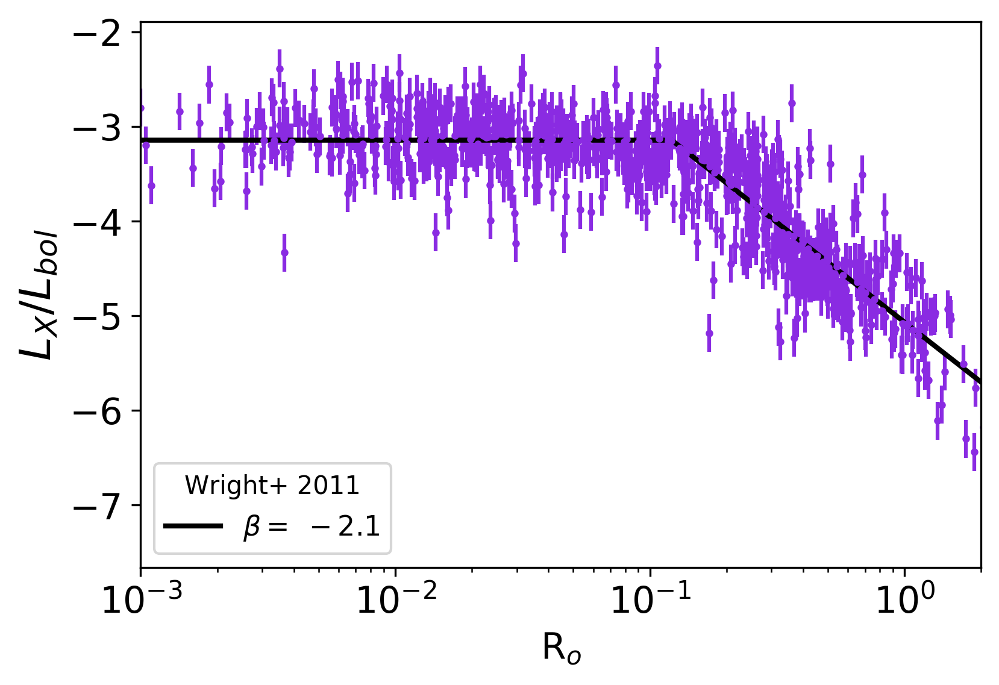

In [ ]:
#now fit Wright data using the MCMC approach
#Set the starting parameters close to, but not exactly at, the Wright et al. best fit values
start_p = np.asarray([-3.2, 0.15, -2., 0.2])

# run the emcee wrapper function 
samples = run_rossby_fit(start_p, np.asarray(WrightData['Rossby_number']), np.asarray(WrightData['log(Lx/Lbol)']), np.ones(num_WrightSources)*0.2 )

# Plot the output
plot_rossby_log(samples, np.asarray(WrightData['Rossby_number']), np.asarray(WrightData['log(Lx/Lbol)']), np.ones(num_WrightSources)*0.2, plotfilename = 'Wright_rossby_MCMCfit.png', sampleName = 'Wright+ 2011')

In [ ]:
# Make a triangle plot 

# Set up the parameters of the problem.
ndim, nsamples = 4, len(samples) 

sl_mcmc = quantile(samples[:,0],[.16,.5,.84])
to_mcmc = quantile(samples[:,1],[.16,.5,.84])
be_mcmc = quantile(samples[:,2],[.16,.5,.84])
var_mcmc = quantile(samples[:,3],[.16,.5,.84])


bestFit = [sl_mcmc[1][1], to_mcmc[1][1], be_mcmc[1][1], var_mcmc[1][1]]

# Plot it.
figure = corner.corner(samples, labels=['sat_level (x10$^{-3}$)','turnover','beta', 'f'],
                       quantiles=[0.16, 0.5, 0.84],
                       show_titles=True, title_kwargs={"fontsize": 12}, truths = bestFit)


# Uncomment to save the plot
plt.savefig('Wright_rossby_corner.png')

In [ ]:
#plot Enza's data
plt.scatter(dataTable['Ro'][detections], dataTable['LxLbol'][detections], marker = '.')
plt.errorbar(dataTable['Ro'][detections], dataTable['LxLbol'][detections], dataTable['eLxLbol'][detections], fmt = '.')
plt.scatter(dataTable['Ro'][upperlimits], dataTable['LxLbol'][upperlimits], marker = 'v')

plt.xscale('log')
#plt.yscale('log')
xlabel = plt.xlabel('Rossby #') 
ylabel = plt.ylabel('Log Lx/Lbol')
plt.axis([10**(-2),3.5,-6,-2])

#check that the log version of the model function is working by calculating model values 
#for the set of fake Rossby's that we created to test the Wright Data
fake_Log_lxlbols_shallow = rossby_model_log([-3.23, 0.08, -1.625], fake_rossbys)
plt.scatter(fake_rossbys, fake_Log_lxlbols_shallow, marker = '.', color = 'green')
fake_Log_lxlbols_steep = rossby_model_log([-3.23, 0.13, -1.66], fake_rossbys)
plt.scatter(fake_rossbys, fake_Log_lxlbols_steep, marker = '.', color = 'red')

plt.savefig('enza_rossby.png', bbox_inches='tight') 

In [ ]:
#plot Enza's data
plt.scatter(dataTable['Prot[d]'][detections], dataTable['Lx[erg/s]'][detections], marker = '.')
plt.errorbar(dataTable['Prot[d]'][detections], dataTable['Lx[erg/s]'][detections], dataTable['eLx[erg/s]'][detections], fmt = '.')
plt.scatter(dataTable['Prot[d]'][upperlimits], dataTable['Lx[erg/s]'][upperlimits], marker = 'v')

plt.xscale('log')
#plt.yscale('log')
xlabel = plt.xlabel(r'P$_{rot}$ [d]') 
ylabel = plt.ylabel(r'Log L$_x$')
plt.axis([0.1,175,25,31.2])

##check that the log version of the model function is working by calculating model values 
##for the set of fake Rossby's that we created to test the Wright Data
#fake_Log_lxlbols_shallow = rossby_model_log([-3.23, 0.08, -1.625], fake_rossbys)
#plt.scatter(fake_rossbys, fake_Log_lxlbols_shallow, marker = '.', color = 'green')
#fake_Log_lxlbols_steep = rossby_model_log([-3.23, 0.13, -1.66], fake_rossbys)
#plt.scatter(fake_rossbys, fake_Log_lxlbols_steep, marker = '.', color = 'red')

plt.savefig('enza_Prot_Lx.png', bbox_inches='tight') 

In [10]:
#class ExpressionSet(RS4):
#    def _mean_get(self):
#        return self.slots['mean']
#    def _mean_set(self, value):
#        self.slots['mean'] = value
#    exprs = property(_mean_get,
#                     _mean_set,
#                     None,
#                     "R attribute `mean`")
    
#def the_mean(eset,
#               na_rm=False):
#    res = cenfit.mean(eset,
#                             na_rm=na_rm)
#    return res

In [21]:
#make a function to do the binning for Enza
def EnzaBins(rossbys, fluxes, fluxFlags, saturatedFlag):

    # import R's "base" package
    base = importr('base')

    # import R's "utils" package
    utils = rpackages.importr('utils') # import R's utility package

    #install NADA once, then just import
    #utils.install_packages('NADA')
    utils.chooseCRANmirror(ind=1) # select the first CRAN mirror in the list for downloading packages
    nada = rpackages.importr('NADA') # import R's utility package

    #my_namespace = dict()
    #dispatch = partial(dispatch, namespace=my_namespace)

    #@dispatch(ExpressionSet)
    
    #now load the cenken package that we want to use to calculate the means
    cenfit = robjects.r['cenfit']
    
    #use the saturated flag to set the boundaries
    if saturatedFlag == True:
        lowerboundaries = [0.0011, 0.0127, 0.0257, 0.0615]
        upperboundaries = [0.0127, 0.0257, 0.0615, 0.120]
    else:
        lowerboundaries = [0.120, 0.228, 0.365, 0.70]
        upperboundaries = [0.228, 0.365, 0.70, 1.665]

    #count the bins we have and set up arrays for storing the results
    n_bins = len(lowerboundaries)
    mean_rossbys = []
    mean_fluxes = []
    
    #loop through the rossbys, fluxes and flags, and find the objects in this bin.
    for i in range(n_bins):
        theserossbys = np.asarray(rossbys[ (rossbys > lowerboundaries[i]) & (rossbys <= upperboundaries[i]) ])
        thesefluxes = np.asarray(-1.* fluxes[ (rossbys > lowerboundaries[i]) & (rossbys <= upperboundaries[i]) ])
        #print(thesefluxes)
        thesefluxflags = np.asarray(fluxFlags[ (rossbys > lowerboundaries[i]) & (rossbys <= upperboundaries[i]) ])
        #print(thesefluxflags)

        #calculate the mean rossby number for objects in the bin
        mean_rossbys = np.append(mean_rossbys, np.mean(theserossbys))
        mean_fluxes_check = np.mean(thesefluxes)
        #create cenken objects to do the KM mean calculation
        fluxes_forMean = robjects.FloatVector(thesefluxes)
        flags_forMean = robjects.BoolVector(thesefluxflags)
    
        cenfit_forMean = cenfit(fluxes_forMean, flags_forMean)
        #print(tuple(cenfit_forMean.slots.keys()))
        print(mean_rossbys[i], mean_fluxes_check)
        print(cenfit_forMean)
        #tuple(cenfit_forMean.slotnames())
        #thisMean = cenfit_forMean.slots['mean']
        #tuple(cenfit_forMean.mean())
        
        #mean(cenfit_forMean)
        #the_mean = cenfit_forMean.mean()
        #mean_fluxes = np.append(mean_fluxes, np.asarray(thisMean))
    
    return mean_rossbys, mean_fluxes

0.008071249973684209 2.9633278421052633
        n     n.cen    median      mean        sd 
38.000000  0.000000  2.880222  2.963328  0.346420 

0.01923870646153846 3.11022058974359
         n      n.cen     median       mean         sd 
39.0000000  0.0000000  3.0674060  3.1102206  0.2954216 

0.040305404175 3.148196275
         n      n.cen     median       mean         sd 
40.0000000  0.0000000  3.0728400  3.1481963  0.3099056 

0.08750710853658537 3.145493951219512
         n      n.cen     median       mean         sd 
41.0000000  0.0000000  3.2014690  3.1454940  0.2680532 

0.17297981437142854 3.3815935714285716
         n      n.cen     median       mean         sd 
35.0000000  0.0000000  3.3045330  3.3815936  0.5000477 

0.28941175636111116 3.7808722777777777
         n      n.cen     median       mean         sd 
36.0000000  0.0000000  3.5365580  3.7808723  0.6110617 

0.4907322342571428 4.272839
         n      n.cen     median       mean         sd 
35.0000000  2.0000000  4.292

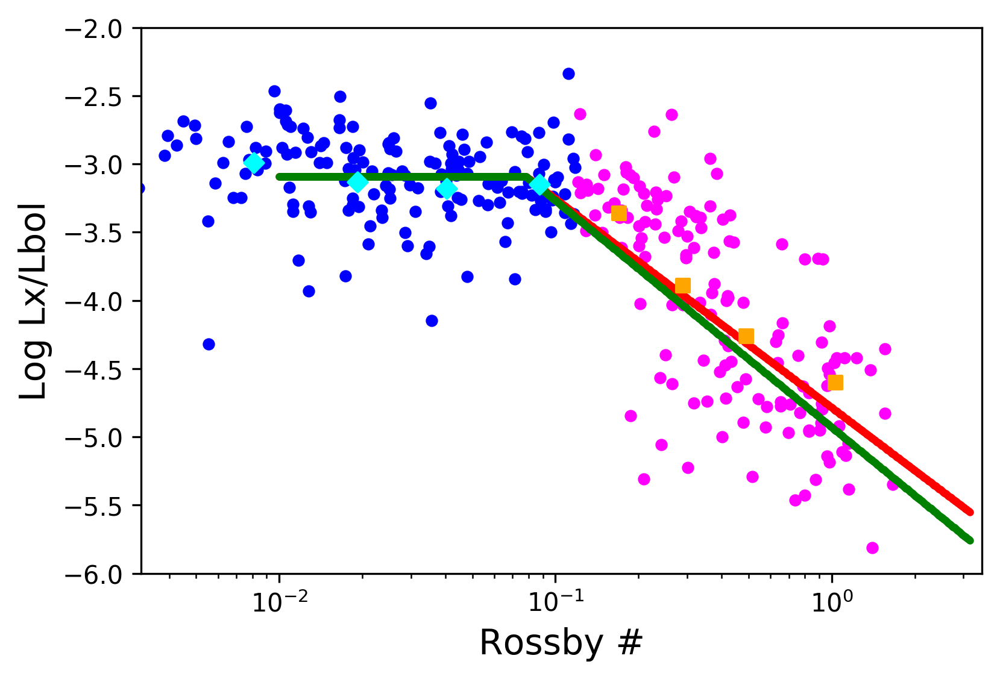

In [22]:
#create arrays where we can save a boolean flag to indicate if the source is an upper limit
num_sources = len(np.asarray(dataTable['UpperLimit']))
RossbyFlag = np.full(num_sources, False)
UpperLimitFlag = np.full(num_sources, False)
UpperLimitFlag[upperlimits] = True

#since we just care about beta, let's truncate the data at R_o = 0.08 so that we can fit one line
fast_rossbys = dataTable['Ro'][(np.asarray(dataTable['Ro']) <= 0.12)]
fast_fluxes = dataTable['LxLbol'][(np.asarray(dataTable['Ro']) <= 0.12)]
fast_rossby_flag = RossbyFlag[((np.asarray(dataTable['Ro']) <= 0.12))]
fast_upperLimit_flag = UpperLimitFlag[((np.asarray(dataTable['Ro']) <= 0.12))]

plt.scatter(fast_rossbys, fast_fluxes, marker = 'o', s = 15, c='blue')

fast_rossby_bins, fast_flux_means = EnzaBins(fast_rossbys, fast_fluxes, fast_upperLimit_flag, True)
fast_rossby_means = [0.008, 0.019, 0.04, 0.088]
fast_flux_means = [-2.99, -3.13, -3.18, -3.15]
fast_flux_sds = [0.34, 0.275, 0.31, 0.26]/np.sqrt(36)

#since we just care about beta, let's truncate the data at R_o = 0.08 so that we can fit one line
slow_rossbys = dataTable['Ro'][(np.asarray(dataTable['Ro']) > 0.12)]
slow_fluxes = dataTable['LxLbol'][(np.asarray(dataTable['Ro']) > 0.12)]
slow_rossby_flag = RossbyFlag[((np.asarray(dataTable['Ro']) > 0.12))]
slow_upperLimit_flag = UpperLimitFlag[((np.asarray(dataTable['Ro']) > 0.12))]

#double-check that this worked by making a plot that shows just the slowly rotating detections and limits
plt.scatter(slow_rossbys, slow_fluxes, marker = 'o', s = 15, c='magenta')

#bin the data as Enza did, and use it to calculate the mean Lx/Lbol values in each bin.
slow_rossby_bins, slow_flux_means = EnzaBins(slow_rossbys, slow_fluxes, slow_upperLimit_flag, False)
#note! can't figure out how to access data from the R object, but I give up -- just transcribe it!
slow_rossby_means = [0.17, 0.29, 0.49, 1.03]
slow_flux_means = [-3.36, -3.89, -4.26, -4.6]
slow_flux_sds = [0.41, 0.62, 0.56, 0.54]/np.sqrt(39)
#cutting at 0.13 changes the first bin to Ro = 0.156  and -3.45

#
fitBins = rossby_model_log([-3.09, 0.078, -1.53], fake_rossbys)
plt.scatter(fake_rossbys, fitBins, marker = '.', color = 'red')
fitBins_steeper = rossby_model_log([-3.09, 0.078, -1.66], fake_rossbys)
plt.scatter(fake_rossbys, fitBins_steeper, marker = '.', color = 'green')

plt.scatter(fast_rossby_bins, fast_flux_means, marker = 'D', s = 30, c='cyan')

#and overlay on the plot
plt.scatter(slow_rossby_means, slow_flux_means, marker = 's', s = 30, c='orange')

plt.xscale('log')
xlabel = plt.xlabel('Rossby #') 
ylabel = plt.ylabel('Log Lx/Lbol')
plt.axis([10**(-2.5),3.5,-6,-2])

plt.savefig('test_upperlimits_rossby.png', bbox_inches='tight') 
#plt.clr()

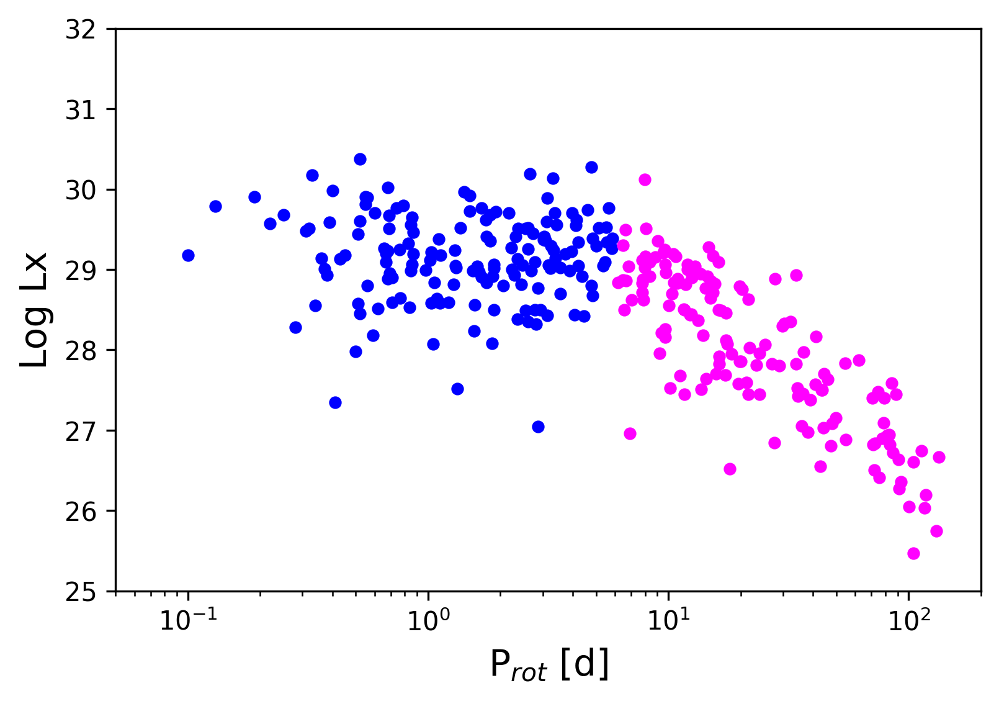

In [36]:
#create arrays where we can save a boolean flag to indicate if the source is an upper limit
num_sources = len(np.asarray(dataTable['UpperLimit']))
RossbyFlag = np.full(num_sources, False)
UpperLimitFlag = np.full(num_sources, False)
UpperLimitFlag[upperlimits] = True

#since we just care about beta, let's truncate the data at R_o = 0.08 so that we can fit one line
fast_rossbys = dataTable['Prot[d]'][(np.asarray(dataTable['Prot[d]']) <= 6)]
fast_fluxes = dataTable['Lx[erg/s]'][(np.asarray(dataTable['Prot[d]']) <= 6)]
fast_rossby_flag = RossbyFlag[((np.asarray(dataTable['Prot[d]']) <= 6))]
fast_upperLimit_flag = UpperLimitFlag[((np.asarray(dataTable['Prot[d]']) <= 6))]

plt.scatter(fast_rossbys, fast_fluxes, marker = 'o', s = 15, c='blue')

#fast_rossby_bins, fast_flux_means = EnzaBins(fast_rossbys, fast_fluxes, fast_upperLimit_flag, True)
#fast_rossby_means = [0.008, 0.019, 0.04, 0.088]
#fast_flux_means = [-2.99, -3.13, -3.18, -3.15]
#fast_flux_sds = [0.34, 0.275, 0.31, 0.26]/np.sqrt(36)

#since we just care about beta, let's truncate the data at R_o = 0.08 so that we can fit one line
slow_rossbys = dataTable['Prot[d]'][(np.asarray(dataTable['Prot[d]']) > 6)]
slow_fluxes = dataTable['Lx[erg/s]'][(np.asarray(dataTable['Prot[d]']) > 6)]
slow_rossby_flag = RossbyFlag[((np.asarray(dataTable['Prot[d]']) > 6))]
slow_upperLimit_flag = UpperLimitFlag[((np.asarray(dataTable['Prot[d]']) > 6))]


#double-check that this worked by making a plot that shows just the slowly rotating detections and limits
plt.scatter(slow_rossbys, slow_fluxes, marker = 'o', s = 15, c='magenta')

#bin the data as Enza did, and use it to calculate the mean Lx/Lbol values in each bin.
#slow_rossby_bins, slow_flux_means = EnzaBins(slow_rossbys, slow_fluxes, slow_upperLimit_flag, False)
#note! can't figure out how to access data from the R object, but I give up -- just transcribe it!
#slow_rossby_means = [0.17, 0.29, 0.49, 1.03]
#slow_flux_means = [-3.36, -3.89, -4.26, -4.6]
#slow_flux_sds = [0.41, 0.62, 0.56, 0.54]/np.sqrt(39)
#cutting at 0.13 changes the first bin to Ro = 0.156  and -3.45

#
#fitBins = rossby_model_log([-3.09, 0.078, -1.53], fake_rossbys)
#plt.scatter(fake_rossbys, fitBins, marker = '.', color = 'red')
#fitBins_steeper = rossby_model_log([-3.09, 0.078, -1.66], fake_rossbys)
#plt.scatter(fake_rossbys, fitBins_steeper, marker = '.', color = 'green')

#plt.scatter(fast_rossby_bins, fast_flux_means, marker = 'D', s = 30, c='cyan')

#and overlay on the plot
#plt.scatter(slow_rossby_means, slow_flux_means, marker = 's', s = 30, c='orange')

plt.xscale('log')
xlabel = plt.xlabel(r'P$_{rot}$ [d]') 
ylabel = plt.ylabel('Log Lx')
plt.axis([0.05,200,25,32])

plt.savefig('test_upperlimits_prot.png', bbox_inches='tight') 
#plt.clr()

intercept constant=30.7617754 +0.1995639/-0.2116544
turnover=7.056 +1.187/-1.205
beta1=-0.103 +0.108/-0.116
beta2=-2.008 +0.147/-0.141
var=-4.034 +0.047/-0.048
292 292 1


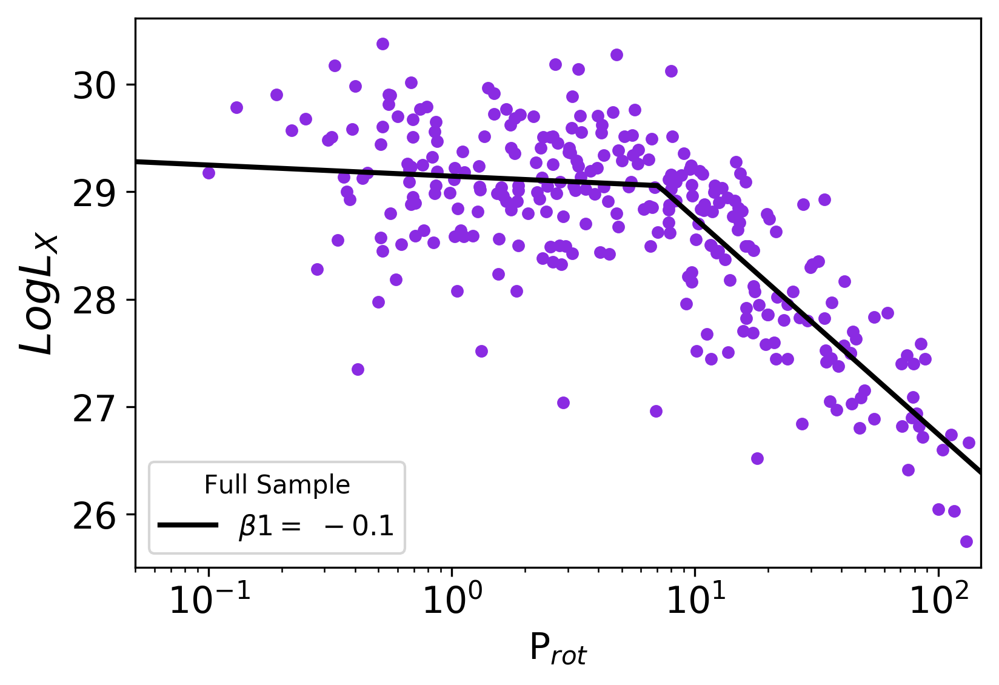

In [53]:
# Decide on your starting parameters
start_p = np.asarray([29.2, 6, -0.15, -1.7, 0.2])

# run the emcee wrapper function -- include all data (including lower limits)
samples = run_dual_fit_periods(start_p, np.asarray(dataTable['Prot[d]'][detections]), np.asarray(dataTable['Lx[erg/s]'][detections]), 0.2*np.ones(len(detections)) )
#returns: sat = -3.09, turnover = 0.078, beta = -1.54

# run the emcee wrapper function -- include just detections (exclude lower limits)
#samples = run_rossby_fit(start_p, np.asarray(dataTable['Ro'][detections]), np.asarray(dataTable['LxLbol_TRUE'][detections]), np.asarray(dataTable['e_LxLbol_KRC_use'][detections]) )
#returns: sat = -3.09, turnover = 0.079, beta = -1.57

# Plot the output
plot_dual_fit_periods(samples, np.asarray(dataTable['Prot[d]'][detections]), np.asarray(dataTable['Lx[erg/s]'][detections]), 0.2*np.ones(len(detections)), plotfilename = 'enza_datapoints_dual_fit_periods.png', sampleName = 'Full Sample')

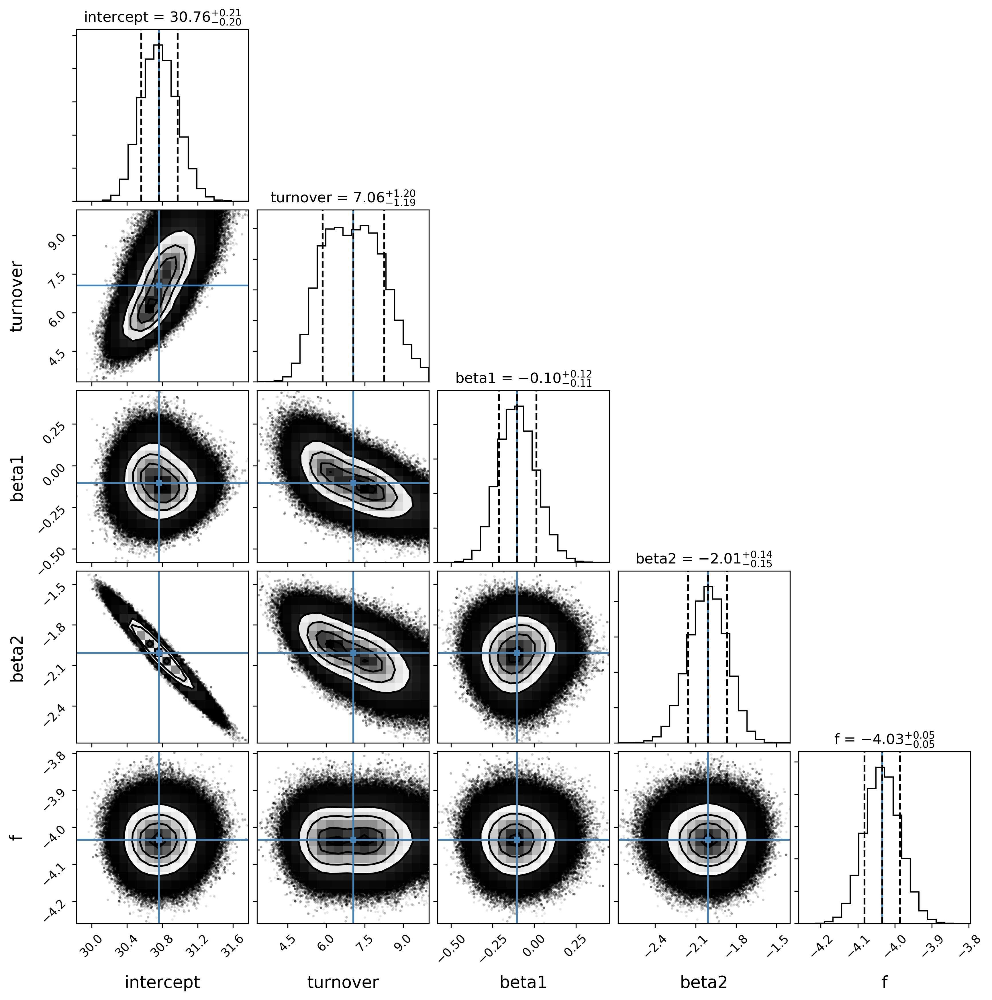

In [54]:
# Make a triangle plot 

# Set up the parameters of the problem.
ndim, nsamples = 5, len(samples) 

ic_mcmc = quantile(samples[:,0],[.16,.5,.84])
to_mcmc = quantile(samples[:,1],[.16,.5,.84])
beta1_mcmc = quantile(samples[:,2],[.16,.5,.84])
beta2_mcmc = quantile(samples[:,3],[.16,.5,.84])
var_mcmc = quantile(samples[:,4],[.16,.5,.84])

bestFit = [ic_mcmc[1][1], to_mcmc[1][1], beta1_mcmc[1][1], beta2_mcmc[1][1], var_mcmc[1][1]]

# Plot it.
figure = corner.corner(samples, labels=['intercept','turnover','beta1', 'beta2', 'f'],
                       quantiles=[0.16, 0.5, 0.84],
                       show_titles=True, title_kwargs={"fontsize": 12}, truths = bestFit)

# Uncomment to save the plot
plt.savefig('enza_datapoints_dual_fit_corner_periods.png')

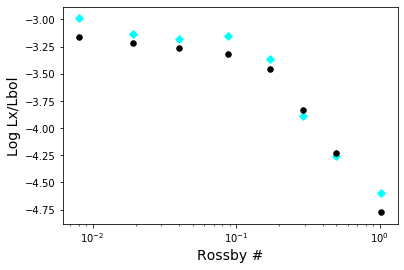

In [14]:
#now do a fit to the means with upper limits included
all_rossby_bins = np.append(fast_rossby_bins, slow_rossby_bins)
all_flux_means = np.append(fast_flux_means, slow_flux_means)
all_flux_sds = np.append(fast_flux_sds, slow_flux_sds)

plt.scatter(all_rossby_bins, all_flux_means, marker = 'D', s = 30, c='cyan')
plt.xscale('log')
xlabel = plt.xlabel('Rossby #') 
ylabel = plt.ylabel('Log Lx/Lbol')
#plt.axis([10**(-2.5),3.5,-6,-2])

try_fit = dual_power_law([-4.75, 0.15, -0.15, -1.7, 0.2],all_rossby_bins)
plt.scatter(all_rossby_bins, try_fit, linestyle = '-', s = 30, c='k')

plt.savefig('test_dual_fit_rossby.png', bbox_inches='tight') 

intercept constant=-4.6597146 +0.0833474/-0.0812384
turnover=0.131 +0.019/-0.021
beta1=-0.148 +0.078/-0.074
beta2=-1.634 +0.154/-0.150
var=-6.304 +2.503/-2.156


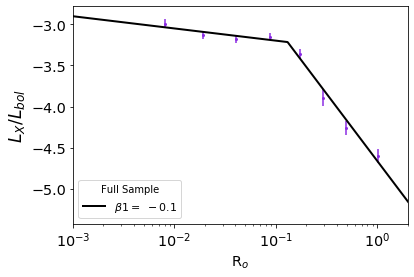

In [15]:
# Decide on your starting parameters
start_p = np.asarray([-4.75, 0.15, -0.15, -1.7, 0.2])

# run the emcee wrapper function -- include all data (including lower limits)
samples = run_dual_fit(start_p, all_rossby_bins, all_flux_means, all_flux_sds )
#returns: sat = -3.09, turnover = 0.078, beta = -1.54

# run the emcee wrapper function -- include just detections (exclude lower limits)
#samples = run_rossby_fit(start_p, np.asarray(dataTable['Ro'][detections]), np.asarray(dataTable['LxLbol_TRUE'][detections]), np.asarray(dataTable['e_LxLbol_KRC_use'][detections]) )
#returns: sat = -3.09, turnover = 0.079, beta = -1.57

# Plot the output
plot_dual_fit(samples, all_rossby_bins, all_flux_means, all_flux_sds, plotfilename = 'enza_binned_dual_fit.png', sampleName = 'Full Sample')

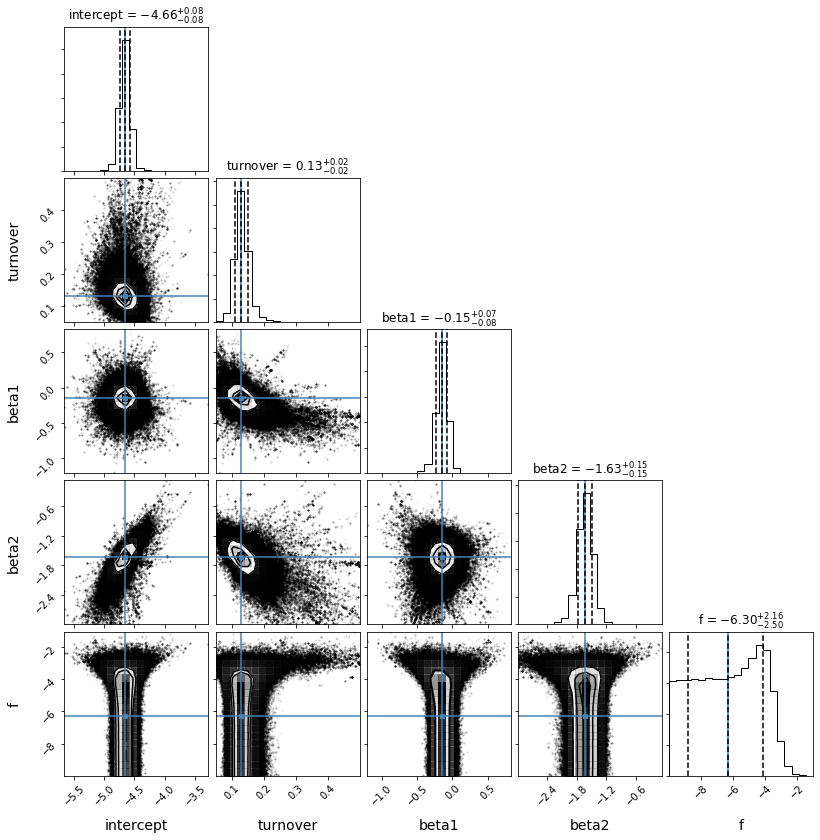

In [16]:
# Make a triangle plot 

# Set up the parameters of the problem.
ndim, nsamples = 5, len(samples) 

ic_mcmc = quantile(samples[:,0],[.16,.5,.84])
to_mcmc = quantile(samples[:,1],[.16,.5,.84])
beta1_mcmc = quantile(samples[:,2],[.16,.5,.84])
beta2_mcmc = quantile(samples[:,3],[.16,.5,.84])
var_mcmc = quantile(samples[:,4],[.16,.5,.84])

bestFit = [ic_mcmc[1][1], to_mcmc[1][1], beta1_mcmc[1][1], beta2_mcmc[1][1], var_mcmc[1][1]]

# Plot it.
figure = corner.corner(samples, labels=['intercept','turnover','beta1', 'beta2', 'f'],
                       quantiles=[0.16, 0.5, 0.84],
                       show_titles=True, title_kwargs={"fontsize": 12}, truths = bestFit)

# Uncomment to save the plot
plt.savefig('enza_binned_dual_fit_corner.png')

intercept constant=-4.7551247 +0.0744588/-0.0728080
turnover=0.122 +0.013/-0.015
beta1=-0.132 +0.068/-0.070
beta2=-1.710 +0.131/-0.125
var=-2.288 +0.052/-0.053


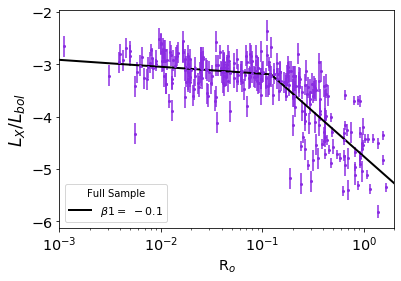

In [45]:
# Decide on your starting parameters
start_p = np.asarray([-4.75, 0.15, -0.15, -1.7, 0.2])

# run the emcee wrapper function -- include all data (including lower limits)
samples = run_dual_fit(start_p, np.asarray(dataTable['Ro'][detections]), np.asarray(dataTable['LxLbol'][detections]), np.asarray(dataTable['e_LxLbol'][detections]) )
#returns: sat = -3.09, turnover = 0.078, beta = -1.54

# run the emcee wrapper function -- include just detections (exclude lower limits)
#samples = run_rossby_fit(start_p, np.asarray(dataTable['Ro'][detections]), np.asarray(dataTable['LxLbol_TRUE'][detections]), np.asarray(dataTable['e_LxLbol_KRC_use'][detections]) )
#returns: sat = -3.09, turnover = 0.079, beta = -1.57

# Plot the output
plot_dual_fit(samples, np.asarray(dataTable['Ro'][detections]), np.asarray(dataTable['LxLbol'][detections]), np.asarray(dataTable['e_LxLbol'][detections]), plotfilename = 'enza_datapoints_dual_fit.png', sampleName = 'Full Sample')

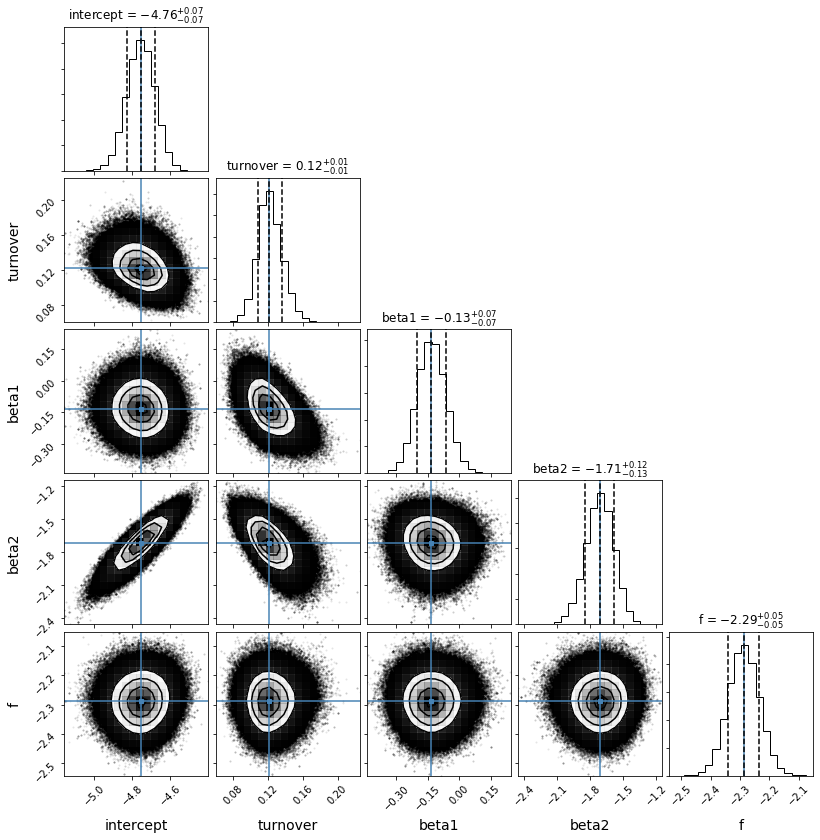

In [46]:
# Make a triangle plot 

# Set up the parameters of the problem.
ndim, nsamples = 5, len(samples) 

ic_mcmc = quantile(samples[:,0],[.16,.5,.84])
to_mcmc = quantile(samples[:,1],[.16,.5,.84])
beta1_mcmc = quantile(samples[:,2],[.16,.5,.84])
beta2_mcmc = quantile(samples[:,3],[.16,.5,.84])
var_mcmc = quantile(samples[:,4],[.16,.5,.84])

bestFit = [ic_mcmc[1][1], to_mcmc[1][1], beta1_mcmc[1][1], beta2_mcmc[1][1], var_mcmc[1][1]]

# Plot it.
figure = corner.corner(samples, labels=['intercept','turnover','beta1', 'beta2', 'f'],
                       quantiles=[0.16, 0.5, 0.84],
                       show_titles=True, title_kwargs={"fontsize": 12}, truths = bestFit)

# Uncomment to save the plot
plt.savefig('enza_datapoints_dual_fit_corner.png')

In [47]:
#Confident that we've isolated the unsaturated regime, now save the vectors to 
#send to r (and convert rossbys to log space, since that is what we want to fit)
Enza_cenken_rossbys = robjects.FloatVector(np.log10(slow_rossbys) )
Enza_cenken_fluxes = robjects.FloatVector(slow_fluxes)
Enza_cenken_rossbyFlags = robjects.BoolVector(slow_rossby_flag)
Enza_cenken_FluxFlags = robjects.BoolVector(slow_upperLimit_flag)

#run the fit!
Enza_cenkenout = cenken(Enza_cenken_fluxes, Enza_cenken_FluxFlags, Enza_cenken_rossbys, Enza_cenken_rossbyFlags)
print(Enza_cenkenout)
# - this gives a fit of beta = -1.625 when cutting at 0.08
# - the slope is 1.66 when cutting at 0.13

slope 
[1] -1.870653

intercept 
NULL

tau 
[1] -0.5355067

p 
[1] 0




/Users/kcovey/anaconda3/envs/pyWithR/lib/python3.7/site-packages/emcee/ensemble.py:335: RuntimeWarning: invalid value encountered in subtract
  lnpdiff = (self.dim - 1.) * np.log(zz) + newlnprob - lnprob0
/Users/kcovey/anaconda3/envs/pyWithR/lib/python3.7/site-packages/emcee/ensemble.py:336: RuntimeWarning: invalid value encountered in greater
  accept = (lnpdiff > np.log(self._random.rand(len(lnpdiff))))


sat_level=-3.1054652 +0.0315134/-0.0303192
turnover=0.117 +0.006/-0.007
beta=-1.873 +0.018/-0.017
var=-2.277 +0.051/-0.055


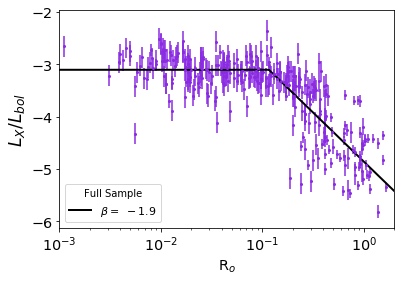

In [23]:
#### now try to fit Enza's data using my updated version of Stephanie's routine's
# Decide on your starting parameters
start_p = np.asarray([-3.2, 0.12, -1.875, -2])

# run the emcee wrapper function -- include all data (including lower limits)
samples = run_rossby_fit(start_p, np.asarray(dataTable['Ro']), np.asarray(dataTable['LxLbol']), np.asarray(dataTable['e_LxLbol']) )
#returns: sat = -3.09, turnover = 0.078, beta = -1.54

# run the emcee wrapper function -- include just detections (exclude lower limits)
#samples = run_rossby_fit(start_p, np.asarray(dataTable['Ro'][detections]), np.asarray(dataTable['LxLbol_TRUE'][detections]), np.asarray(dataTable['e_LxLbol_KRC_use'][detections]) )
#returns: sat = -3.09, turnover = 0.079, beta = -1.57

# Plot the output
plot_rossby_log(samples, np.asarray(dataTable['Ro']), np.asarray(dataTable['LxLbol']), np.asarray(dataTable['e_LxLbol']), plotfilename = 'enza_rossby_forced_slope_fit.png', sampleName = 'Full Sample')

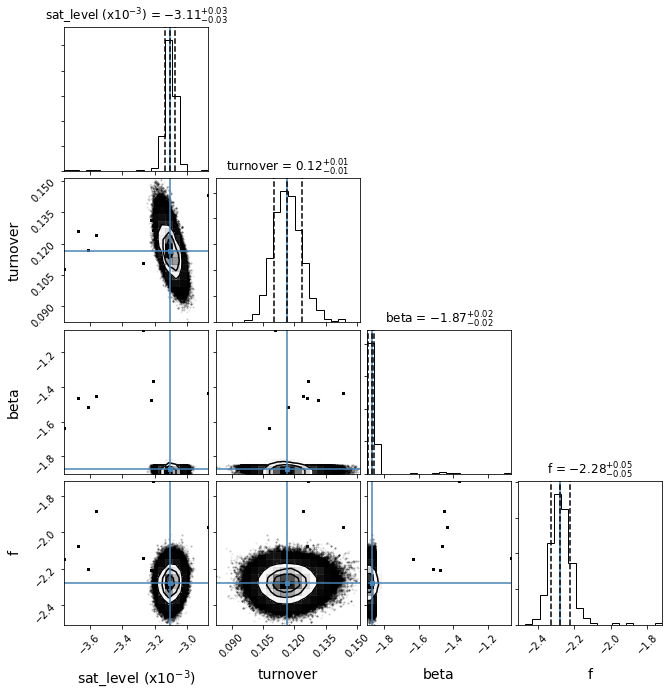

In [24]:
# Make a triangle plot 

# Set up the parameters of the problem.
ndim, nsamples = 4, len(samples) 

sl_mcmc = quantile(samples[:,0],[.16,.5,.84])
to_mcmc = quantile(samples[:,1],[.16,.5,.84])
be_mcmc = quantile(samples[:,2],[.16,.5,.84])
var_mcmc = quantile(samples[:,3],[.16,.5,.84])


bestFit = [sl_mcmc[1][1], to_mcmc[1][1], be_mcmc[1][1], var_mcmc[1][1]]

# Plot it.
figure = corner.corner(samples, labels=['sat_level (x10$^{-3}$)','turnover','beta', 'f'],
                       quantiles=[0.16, 0.5, 0.84],
                       show_titles=True, title_kwargs={"fontsize": 12}, truths = bestFit)


# Uncomment to save the plot
plt.savefig('enza_rossby_corner_forced_fit.png')

In [28]:
#use the Jao Gap to divide the sample into full and partially convective stars
fully_convective = np.where(dataTable['Abs_Mks[mag]'] >= 6.7)
partially_convective = np.where(dataTable['Abs_Mks[mag]'] < 6.7)

#use the Jao Gap to divide the sample into full and partially convective stars
slow_fully_convective = np.where( (dataTable['Abs_Mks[mag]'] >= 6.7) & (dataTable['Ro'] >= 0.12) )
slow_partially_convective = np.where( (dataTable['Abs_Mks[mag]'] < 6.7) & (dataTable['Ro'] >= 0.12) )

#Confident that we've isolated the unsaturated regime, now save the vectors to 
#send to r (and convert rossbys to log space, since that is what we want to fit)
Enza_cenken_slow_fully_rossbys = robjects.FloatVector(np.log10(dataTable['Ro'][slow_fully_convective]) )
Enza_cenken_slow_fully_fluxes = robjects.FloatVector(dataTable['LxLbol'][slow_fully_convective])
Enza_cenken_slow_fully_rossbyFlags = robjects.BoolVector(RossbyFlag[slow_fully_convective])
Enza_cenken_slow_fully_FluxFlags = robjects.BoolVector(UpperLimitFlag[slow_fully_convective])

#run the fit!
Enza_slow_fully_cenkenout = cenken(Enza_cenken_slow_fully_fluxes, Enza_cenken_slow_fully_FluxFlags, Enza_cenken_slow_fully_rossbys, Enza_cenken_slow_fully_rossbyFlags)
print(Enza_slow_fully_cenkenout)
# - this gives a fit of beta = -1.625 when cutting at 0.08
# - the slope is 1.66 when cutting at 0.13

slope 
[1] -2.046901

intercept 
NULL

tau 
[1] -0.4258065

p 
[1] 0.0007349289




In [29]:
#Confident that we've isolated the unsaturated regime, now save the vectors to 
#send to r (and convert rossbys to log space, since that is what we want to fit)
Enza_cenken_slow_partially_rossbys = robjects.FloatVector(np.log10(dataTable['Ro'][slow_partially_convective]) )
Enza_cenken_slow_partially_fluxes = robjects.FloatVector(dataTable['LxLbol'][slow_partially_convective])
Enza_cenken_slow_partially_rossbyFlags = robjects.BoolVector(RossbyFlag[slow_partially_convective])
Enza_cenken_slow_partially_FluxFlags = robjects.BoolVector(UpperLimitFlag[slow_partially_convective])

#run the fit!
Enza_slow_partially_cenkenout = cenken(Enza_cenken_slow_partially_fluxes, Enza_cenken_slow_partially_FluxFlags, Enza_cenken_slow_partially_rossbys, Enza_cenken_slow_partially_rossbyFlags)
print(Enza_slow_partially_cenkenout)

slope 
[1] -2.04375

intercept 
NULL

tau 
[1] -0.5529279

p 
[1] 0




/Users/kcovey/anaconda3/envs/pyWithR/lib/python3.7/site-packages/emcee/ensemble.py:335: RuntimeWarning: invalid value encountered in subtract
  lnpdiff = (self.dim - 1.) * np.log(zz) + newlnprob - lnprob0
/Users/kcovey/anaconda3/envs/pyWithR/lib/python3.7/site-packages/emcee/ensemble.py:336: RuntimeWarning: invalid value encountered in greater
  accept = (lnpdiff > np.log(self._random.rand(len(lnpdiff))))


sat_level=-3.1603995 +0.1754180/-0.1244491
turnover=0.150 +0.020/-0.019
beta=-1.854 +0.030/-0.497
var=-1.943 +0.211/-2.150


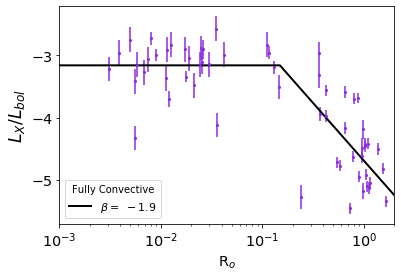

In [30]:
#### now try to fit Enza's data using my updated version of Stephanie's routine's
# Decide on your starting parameters
start_p = np.asarray([-3.2, 0.15, -1.5, 0.2])

# run the emcee wrapper function -- include all data (including lower limits)
samples = run_rossby_fit(start_p, np.asarray(dataTable['Ro'][fully_convective]), np.asarray(dataTable['LxLbol'][fully_convective]), np.asarray(dataTable['e_LxLbol'][fully_convective]) )
#returns: sat = -3.09, turnover = 0.08, beta = -1.57
#plot the output
plot_rossby_log(samples, np.asarray(dataTable['Ro'][fully_convective]), np.asarray(dataTable['LxLbol'][fully_convective]), np.asarray(dataTable['e_LxLbol'][fully_convective]), plotfilename = 'enza_rossby_fit_fully_convective.png', sampleName = 'Fully Convective')

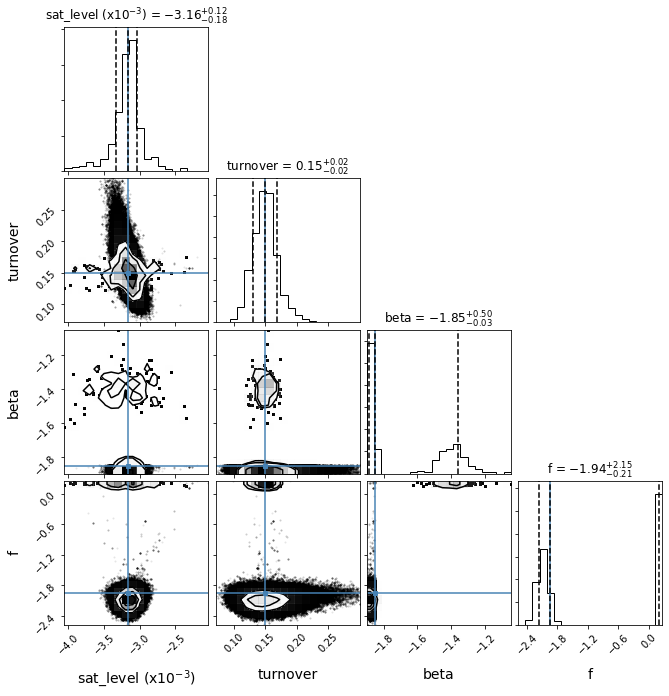

In [31]:
# Make a triangle plot 

# Set up the parameters of the problem.
ndim, nsamples = 4, len(samples) 

sl_mcmc = quantile(samples[:,0],[.16,.5,.84])
to_mcmc = quantile(samples[:,1],[.16,.5,.84])
be_mcmc = quantile(samples[:,2],[.16,.5,.84])
var_mcmc = quantile(samples[:,3],[.16,.5,.84])


bestFit = [sl_mcmc[1][1], to_mcmc[1][1], be_mcmc[1][1], var_mcmc[1][1]]

# Plot it.
figure = corner.corner(samples, labels=['sat_level (x10$^{-3}$)','turnover','beta', 'f'],
                       quantiles=[0.16, 0.5, 0.84],
                       show_titles=True, title_kwargs={"fontsize": 12}, truths = bestFit)


# Uncomment to save the plot
plt.savefig('enza_rossby_corner_fully_convective.png')

/Users/kcovey/anaconda3/envs/pyWithR/lib/python3.7/site-packages/emcee/ensemble.py:335: RuntimeWarning: invalid value encountered in subtract
  lnpdiff = (self.dim - 1.) * np.log(zz) + newlnprob - lnprob0
/Users/kcovey/anaconda3/envs/pyWithR/lib/python3.7/site-packages/emcee/ensemble.py:336: RuntimeWarning: invalid value encountered in greater
  accept = (lnpdiff > np.log(self._random.rand(len(lnpdiff))))


sat_level=-3.1068749 +0.1925850/-0.0888632
turnover=0.129 +0.021/-0.028
beta=-1.506 +0.378/-0.152
var=0.172 +2.540/-0.039


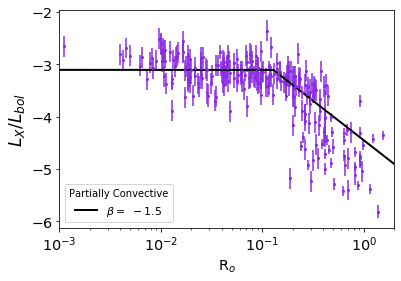

In [32]:
# run the emcee wrapper function -- include just detections (exclude lower limits)
samples = run_rossby_fit(start_p, np.asarray(dataTable['Ro'][partially_convective]), np.asarray(dataTable['LxLbol'][partially_convective]), np.asarray(dataTable['e_LxLbol'][partially_convective]) )
#returns: sat = -3.09, turnover = 0.08, beta = -1.57

# Plot the output
plot_rossby_log(samples, np.asarray(dataTable['Ro'][partially_convective]), np.asarray(dataTable['LxLbol'][partially_convective]), np.asarray(dataTable['e_LxLbol'][partially_convective]), plotfilename = 'enza_rossby_fit_partially_convective.png', sampleName = 'Partially Convective')

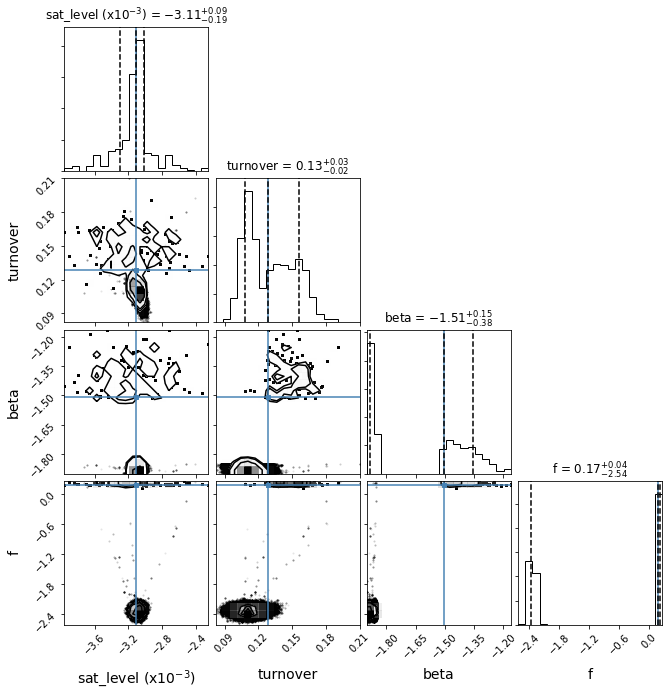

In [33]:
# Make a triangle plot 

# Set up the parameters of the problem.
ndim, nsamples = 4, len(samples) 

sl_mcmc = quantile(samples[:,0],[.16,.5,.84])
to_mcmc = quantile(samples[:,1],[.16,.5,.84])
be_mcmc = quantile(samples[:,2],[.16,.5,.84])
var_mcmc = quantile(samples[:,3],[.16,.5,.84])


bestFit = [sl_mcmc[1][1], to_mcmc[1][1], be_mcmc[1][1], var_mcmc[1][1]]

# Plot it.
figure = corner.corner(samples, labels=['sat_level (x10$^{-3}$)','turnover','beta', 'f'],
                       quantiles=[0.16, 0.5, 0.84],
                       show_titles=True, title_kwargs={"fontsize": 12}, truths = bestFit)

# Uncomment to save the plot
plt.savefig('enza_rossby_corner_partially_convective.png')

In [ ]:
#divide the sample into other spectral type slices (using MKs from Kraus 2007)
effg = np.where( (dataTable['Mks_TRUE'] >= 2) & (dataTable['Mks_TRUE'] < 4) )
kays = np.where( (dataTable['Mks_TRUE'] >= 4) & (dataTable['Mks_TRUE'] < 5.18) )
early_ems = np.where( (dataTable['Mks_TRUE'] >= 5.18) & (dataTable['Mks_TRUE'] < 6.7) )

In [ ]:
#### now try to fit Enza's data using my updated version of Stephanie's routine's
# Decide on your starting parameters
start_p = np.asarray([-3.2, 0.15, -1.5, 0.2])

# run the emcee wrapper function -- include all data (including lower limits)
samples = run_rossby_fit(start_p, np.asarray(dataTable['Ro'][effg]), np.asarray(dataTable['LxLbol_TRUE'][effg]), np.asarray(dataTable['e_LxLbol_KRC_use'][effg]) )
#returns: sat = -3.13, turnover = 0.06, beta = -2.36
#plot the output
plot_rossby_log(samples, np.asarray(dataTable['Ro'][effg]), np.asarray(dataTable['LxLbol_TRUE'][effg]), np.asarray(dataTable['e_LxLbol_KRC_use'][effg]), plotfilename = 'enza_rossby_fit_effg.png', sampleName = 'FG stars')

In [ ]:
# Make a triangle plot 

# Set up the parameters of the problem.
ndim, nsamples = 4, len(samples) 

sl_mcmc = quantile(samples[:,0],[.16,.5,.84])
to_mcmc = quantile(samples[:,1],[.16,.5,.84])
be_mcmc = quantile(samples[:,2],[.16,.5,.84])
var_mcmc = quantile(samples[:,3],[.16,.5,.84])

bestFit = [sl_mcmc[1][1], to_mcmc[1][1], be_mcmc[1][1], var_mcmc[1][1]]

# Plot it.
figure = corner.corner(samples, labels=['sat_level (x10$^{-3}$)','turnover','beta', 'f'],
                       quantiles=[0.16, 0.5, 0.84],
                       show_titles=True, title_kwargs={"fontsize": 12}, truths = bestFit)


# Uncomment to save the plot
plt.savefig('enza_rossby_corner_effg.png')

In [ ]:
#### now try to fit Enza's data using my updated version of Stephanie's routine's
# Decide on your starting parameters
start_p = np.asarray([-3.2, 0.15, -1.5, 0.2])

# run the emcee wrapper function -- include all data (including lower limits)
samples = run_rossby_fit(start_p, np.asarray(dataTable['Ro'][kays]), np.asarray(dataTable['LxLbol_TRUE'][kays]), np.asarray(dataTable['e_LxLbol_KRC_use'][kays]) )
#returns: sat = -3.09, turnover = 0.08, beta = -1.57
#plot the output
plot_rossby_log(samples, np.asarray(dataTable['Ro'][kays]), np.asarray(dataTable['LxLbol_TRUE'][kays]), np.asarray(dataTable['e_LxLbol_KRC_use'][kays]), plotfilename = 'enza_rossby_fit_kays.jpg', sampleName = 'K stars')

# Make a triangle plot 

# Set up the parameters of the problem.
ndim, nsamples = 4, len(samples) 

sl_mcmc = quantile(samples[:,0],[.16,.5,.84])
to_mcmc = quantile(samples[:,1],[.16,.5,.84])
be_mcmc = quantile(samples[:,2],[.16,.5,.84])
var_mcmc = quantile(samples[:,3],[.16,.5,.84])

bestFit = [sl_mcmc[1][1], to_mcmc[1][1], be_mcmc[1][1], var_mcmc[1][1]]

# Plot it.
figure = corner.corner(samples, labels=['sat_level (x10$^{-3}$)','turnover','beta', 'f'],
                       quantiles=[0.16, 0.5, 0.84],
                       show_titles=True, title_kwargs={"fontsize": 12}, truths = bestFit)


# Uncomment to save the plot
plt.savefig('enza_rossby_corner_kays.png')

In [ ]:
#### now try to fit Enza's data using my updated version of Stephanie's routine's
# Decide on your starting parameters
start_p = np.asarray([-3.2, 0.15, -1.5, 0.2])

# run the emcee wrapper function -- include all data (including lower limits)
samples = run_rossby_fit(start_p, np.asarray(dataTable['Ro'][early_ems]), np.asarray(dataTable['LxLbol_TRUE'][early_ems]), np.asarray(dataTable['e_LxLbol_KRC_use'][early_ems]) )
#returns: sat = -3.09, turnover = 0.13, beta = -2.1
#plot the output
plot_rossby_log(samples, np.asarray(dataTable['Ro'][early_ems]), np.asarray(dataTable['LxLbol_TRUE'][early_ems]), np.asarray(dataTable['e_LxLbol_KRC_use'][early_ems]), plotfilename = 'enza_rossby_fit_earlyems.jpg', sampleName = 'Early M stars')

# Make a triangle plot 

# Set up the parameters of the problem.
ndim, nsamples = 4, len(samples) 

sl_mcmc = quantile(samples[:,0],[.16,.5,.84])
to_mcmc = quantile(samples[:,1],[.16,.5,.84])
be_mcmc = quantile(samples[:,2],[.16,.5,.84])
var_mcmc = quantile(samples[:,3],[.16,.5,.84])

bestFit = [sl_mcmc[1][1], to_mcmc[1][1], be_mcmc[1][1], var_mcmc[1][1]]

# Plot it.
figure = corner.corner(samples, labels=['sat_level (x10$^{-3}$)','turnover','beta', 'f'],
                       quantiles=[0.16, 0.5, 0.84],
                       show_titles=True, title_kwargs={"fontsize": 12}, truths = bestFit)


# Uncomment to save the plot
plt.savefig('enza_rossby_corner_earlyems.png')

In [ ]:
exponents = [0,0,1,1]

In [ ]:
print(np.mean(exponents))

In [ ]:
notexponents = [10**0, 10**0, 10**1, 10**1]

In [ ]:
print(np.log10(np.mean(notexponents)))

In [ ]:
print(np.log10(np.mean([10.**0.4,10.**0.6])))